In [1]:
from keras import Input, layers, backend, Model, losses, datasets, models, metrics, optimizers, initializers
from keras.utils import Sequence
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import math

In [12]:

class FelixSequence(Sequence):
    def __init__(self, x_set, y_set, batch_size):
        """Here self.x is a list of paths to .npy input files. self.y is a
        corresponding list of paths to .npy output files."""
        self.x, self.y = x_set, y_set
        self.batch_size = batch_size

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        batch_x = self.x[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.y[idx * self.batch_size:(idx + 1) * self.batch_size]
        #print(np.array([np.load(file_name) for file_name in batch_x]).shape, np.array([np.load(file_name) for file_name in batch_y]).shape)
        return np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_x]), np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_y])
    

def gen_paths_labels(base_path = "D:\\Uni Work\\Masters Project\\electron_dists\\Data\\VAE_000_1\\Data"):
    """A generator to yield (data-paths, corresponding labels) tuples for each
    segment of data (typically training, validation, and testing)."""
    for segment in sorted(os.listdir(base_path)):
        segment_path = os.path.join(base_path, segment)
        input_paths = []
        output_paths = []
        for crystal in sorted(os.listdir(segment_path)):
            crystal_path = os.path.join(segment_path, crystal)
            files = sorted(os.listdir(crystal_path))
            input_paths.append(os.path.join(crystal_path, files[0]))
            output_paths.append(os.path.join(crystal_path, files[1]))
        yield [input_paths, output_paths]

def gen_paths_fromfile(Path):
    input_paths = []
    output_paths = []
    with open(Path) as textFile:
        lines = [line.split() for line in textFile]
    #print(lines)
    for i in lines:
        output_paths.append(i[0])
        input_paths.append(i[0].split("Output.npy")[0] + "Input.npy")
    return([input_paths, output_paths])

In [3]:
latent_dim = 10

"""
## Create a sampling layer
"""
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


In [4]:
"""
## Build the encoder
"""

NoKernel2 = 1
NoKernel4 = 1
NoKernel8 = 8
NoKernel16 = 1

encoder_inputs = Input(shape=(128, 128, 1))
Layer_Encode_1_K2 = layers.Conv2D(NoKernel2, kernel_size = (2, 2), activation="relu", strides=2, padding="same")(encoder_inputs)
Layer_Encode_1_K4 = layers.Conv2D(NoKernel4, kernel_size = (4, 4), activation="relu", strides=2, padding="same")(encoder_inputs)
Layer_Encode_1_K8 = layers.Conv2D(NoKernel8, kernel_size = (8, 8), activation="relu", strides=2, padding="same")(encoder_inputs)
Layer_Encode_1_K16 = layers.Conv2D(NoKernel16, kernel_size = (16, 16), activation="relu", strides=2, padding="same")(encoder_inputs)
Layer_Encode_1 = layers.concatenate([Layer_Encode_1_K2, Layer_Encode_1_K4, Layer_Encode_1_K8, Layer_Encode_1_K16])

Layer_Encode_2_K2 = layers.Conv2D(NoKernel2, kernel_size = (2, 2), activation="relu", strides=2, padding="same")(Layer_Encode_1)
Layer_Encode_2_K4 = layers.Conv2D(NoKernel4, kernel_size = (4, 4), activation="relu", strides=2, padding="same")(Layer_Encode_1)
Layer_Encode_2_K8 = layers.Conv2D(NoKernel8, kernel_size = (8, 8), activation="relu", strides=2, padding="same")(Layer_Encode_1)
Layer_Encode_2_K16 = layers.Conv2D(NoKernel16, kernel_size = (16, 16), activation="relu", strides=2, padding="same")(Layer_Encode_1)
Layer_Encode_2 = layers.concatenate([Layer_Encode_2_K2, Layer_Encode_2_K4, Layer_Encode_2_K8, Layer_Encode_2_K16])



x = layers.Flatten()(Layer_Encode_2)


DenseParam_Encode = 1500000
DenseNeurons_Encode = int(DenseParam_Encode / (x.shape[1]))

x = layers.Dense(DenseNeurons_Encode, activation="relu")(x)
z_mean = layers.Dense(latent_dim, name="z_mean")(x)
z_log_var = layers.Dense(latent_dim, name="z_log_var", kernel_initializer='zeros', bias_initializer='zeros')(x)
z = Sampling()([z_mean, z_log_var])
encoder = Model(encoder_inputs, [z_mean, z_log_var, z], name="encoder")
encoder.summary()

Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 64, 64, 1)    5           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 64, 64, 1)    17          input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 64, 64, 8)    520         input_1[0][0]                    
____________________________________________________________________________________________

In [5]:
"""
## Build the decoder
"""


Dense_Size = Layer_Encode_2.shape[1]
DenseParam_Decode = 1500000
Dense_Depth = int(DenseParam_Decode / (latent_dim * Dense_Size * Dense_Size))

latent_inputs = Input(shape=(latent_dim,))
x = layers.Dense(Dense_Size * Dense_Size * Dense_Depth, activation="relu")(latent_inputs)
x = layers.Reshape((Dense_Size, Dense_Size, Dense_Depth))(x)

Layer_Decode_1_K2 = layers.Conv2DTranspose(NoKernel2, kernel_size = (2, 2), activation="relu", strides=2, padding="same")(x)
Layer_Decode_1_K4 = layers.Conv2DTranspose(NoKernel4, kernel_size = (4, 4), activation="relu", strides=2, padding="same")(x)
Layer_Decode_1_K8 = layers.Conv2DTranspose(NoKernel8, kernel_size = (8, 8), activation="relu", strides=2, padding="same")(x)
Layer_Decode_1_K16 = layers.Conv2DTranspose(NoKernel16, kernel_size = (16, 16), activation="relu", strides=2, padding="same")(x)
Layer_Decode_1 = layers.concatenate([Layer_Decode_1_K2, Layer_Decode_1_K4, Layer_Decode_1_K8, Layer_Decode_1_K16])

Layer_Decode_2_K2 = layers.Conv2DTranspose(NoKernel2, kernel_size = (2, 2), activation="relu", strides=2, padding="same")(Layer_Decode_1)
Layer_Decode_2_K4 = layers.Conv2DTranspose(NoKernel4, kernel_size = (4, 4), activation="relu", strides=2, padding="same")(Layer_Decode_1)
Layer_Decode_2_K8 = layers.Conv2DTranspose(NoKernel8, kernel_size = (8, 8), activation="relu", strides=2, padding="same")(Layer_Decode_1)
Layer_Decode_2_K16 = layers.Conv2DTranspose(NoKernel16, kernel_size = (16, 16), activation="relu", strides=2, padding="same")(Layer_Decode_1)
Layer_Decode_2 = layers.concatenate([Layer_Decode_2_K2, Layer_Decode_2_K4, Layer_Decode_2_K8, Layer_Decode_2_K16])



decoder_outputs = layers.Conv2DTranspose(1, kernel_size = (2, 2), activation="relu", padding= "same")(Layer_Decode_2)
decoder = Model(latent_inputs, decoder_outputs, name="decoder")

decoder.summary()




Model: "decoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 10)]         0                                            
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 149504)       1644544     input_2[0][0]                    
__________________________________________________________________________________________________
reshape (Reshape)               (None, 32, 32, 146)  0           dense_1[0][0]                    
__________________________________________________________________________________________________
conv2d_transpose (Conv2DTranspo (None, 64, 64, 1)    585         reshape[0][0]                    
____________________________________________________________________________________________

In [6]:
class VAE(Model):
    def __init__(self, encoder, decoder, **kwargs):
        super(VAE, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker
        ]

    def train_step(self, data):
        x, y = data
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.encoder(x)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
                )
            )
            #print(z_mean, z_log_var, z)
            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)

        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result()
        }

    def call(self, data):
        return self.decoder(self.encoder(data)[2])

#losses.MSE(y, reconstruction), axis=(1, 2)
#losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)

In [7]:
#vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_3")

vae = VAE(encoder, decoder)
#vae.add_metric(trainable_metric(vae), name="testMetric")
vae.compile(optimizer=optimizers.Adam())


batch_size=64
#data_path = "/home/ug-ml/felix-ML/VAE_000/Data/FilePaths/"
data_path = "/home/ug-ml/felix-ML/VAE_000/Data/Data/"

data = [i for i in gen_paths_labels(data_path)]

val_seq = FelixSequence(data[2][0], data[2][1], batch_size)
train_seq = FelixSequence(data[1][0], data[1][1], batch_size)
test_seq = FelixSequence(data[0][0], data[0][1], batch_size)

#ValidationPaths = gen_paths_fromfile(data_path + "Validation_50.txt")
#TrainingPaths = gen_paths_fromfile(data_path + "Training_50.txt")
#TestPaths = gen_paths_fromfile(data_path + "Test_50.txt")

#val_seq = FelixSequence(ValidationPaths[0], ValidationPaths[1], batch_size)
#train_seq = FelixSequence(TrainingPaths[0], TrainingPaths[1], batch_size)
#test_seq = FelixSequence(TestPaths[0], TestPaths[1], batch_size)

#vae.fit(train_seq, shuffle=True, workers=16, epochs=1500)

epochs = 1500
patience = 50


patience_i = 0
best_val_loss = np.inf

#training and validation histories, containing [0] the total loss, [1] the reconstruction loss, and [2] the kl loss.
val_hist = np.zeros(shape=(1,epochs))
train_hist = np.zeros(shape=(3,epochs))

for epoch in range(0, epochs):
    print("-------------------------------------------------------------------------")
    print("Epoch", epoch, "/", epochs, ": ")
    print("Training: ")
    hist = vae.fit(x = train_seq, shuffle=True, epochs = epoch+1, workers = 16, initial_epoch=epoch)
    train_hist[0][epoch] = hist.history["loss"][0]
    train_hist[1][epoch] = hist.history["reconstruction_loss"][0]
    train_hist[2][epoch] = hist.history["kl_loss"][0]
    print("Validation: ")

    tot_batch_recon_loss = 0
    count = 0
    for x, y in val_seq:
        #rint(x.shape, y.shape)
        count += 1
        reconstruction = vae(x)
        reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
                )
            )
        tot_batch_recon_loss += reconstruction_loss
        #print(batch_log_loss)
    
    avg_recon_loss = float(tot_batch_recon_loss/count)
    if(avg_recon_loss < best_val_loss):
        print("The model improved from: ",best_val_loss, "to: ", avg_recon_loss)
        best_val_loss = avg_recon_loss
        patience_i = 0
    else:
        patience_i+=1
        print("The model did not improve, patience_i = ", patience_i)
        
    print("Average reconstruction loss: ", avg_recon_loss)
    val_hist[0][epoch] = avg_recon_loss
    if(patience_i > patience):
        print("Early Stopping, the model did not improve from: ", best_val_loss)
        break

print("-------------------------------------------------------------------------")
print("Testing: ")
loss = vae.evaluate(test_seq)
print("loss: "+str(loss))



-------------------------------------------------------------------------
Epoch 0 / 1500 : 
Training: 
91/91 [==============================] - 10s 109ms/step - loss: 1165.7454 - reconstruction_loss: 1031.3103 - kl_loss: 4.6505
Validation: 
The model improved from:  inf to:  443.7972717285156
Average reconstruction loss:  443.7972717285156
-------------------------------------------------------------------------
Epoch 1 / 1500 : 
Training: 
Epoch 2/2
91/91 [==============================] - 11s 120ms/step - loss: 394.6472 - reconstruction_loss: 353.6799 - kl_loss: 11.0013
Validation: 
The model improved from:  443.7972717285156 to:  296.634765625
Average reconstruction loss:  296.634765625
-------------------------------------------------------------------------
Epoch 2 / 1500 : 
Training: 
Epoch 3/3
91/91 [==============================] - 11s 123ms/step - loss: 310.3993 - reconstruction_loss: 283.3571 - kl_loss: 14.2534
Validation: 
The model improved from:  296.634765625 to:  268.31

91/91 [==============================] - 10s 112ms/step - loss: 110.6052 - reconstruction_loss: 89.1002 - kl_loss: 21.9632
Validation: 
The model improved from:  143.83169555664062 to:  142.55430603027344
Average reconstruction loss:  142.55430603027344
-------------------------------------------------------------------------
Epoch 23 / 1500 : 
Training: 
Epoch 24/24
91/91 [==============================] - 10s 113ms/step - loss: 108.9079 - reconstruction_loss: 88.3187 - kl_loss: 22.0709
Validation: 
The model improved from:  142.55430603027344 to:  141.71836853027344
Average reconstruction loss:  141.71836853027344
-------------------------------------------------------------------------
Epoch 24 / 1500 : 
Training: 
Epoch 25/25
91/91 [==============================] - 10s 114ms/step - loss: 105.8883 - reconstruction_loss: 85.7496 - kl_loss: 22.1343
Validation: 
The model improved from:  141.71836853027344 to:  138.10838317871094
Average reconstruction loss:  138.10838317871094
------

91/91 [==============================] - 10s 111ms/step - loss: 78.5721 - reconstruction_loss: 59.0185 - kl_loss: 22.5483
Validation: 
The model improved from:  122.60826873779297 to:  122.0838623046875
Average reconstruction loss:  122.0838623046875
-------------------------------------------------------------------------
Epoch 46 / 1500 : 
Training: 
Epoch 47/47
91/91 [==============================] - 11s 121ms/step - loss: 81.7776 - reconstruction_loss: 59.9753 - kl_loss: 22.5527s -
Validation: 
The model improved from:  122.0838623046875 to:  121.94721984863281
Average reconstruction loss:  121.94721984863281
-------------------------------------------------------------------------
Epoch 47 / 1500 : 
Training: 
Epoch 48/48
91/91 [==============================] - 11s 123ms/step - loss: 80.6071 - reconstruction_loss: 58.4990 - kl_loss: 22.5763s - loss:
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  123.10099792480469
--------------------------

91/91 [==============================] - 11s 123ms/step - loss: 69.1025 - reconstruction_loss: 47.1485 - kl_loss: 22.5931
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  115.58760070800781
-------------------------------------------------------------------------
Epoch 69 / 1500 : 
Training: 
Epoch 70/70
91/91 [==============================] - 11s 121ms/step - loss: 67.3998 - reconstruction_loss: 46.2337 - kl_loss: 22.5723
Validation: 
The model did not improve, patience_i =  2
Average reconstruction loss:  116.79607391357422
-------------------------------------------------------------------------
Epoch 70 / 1500 : 
Training: 
Epoch 71/71
91/91 [==============================] - 10s 115ms/step - loss: 67.0632 - reconstruction_loss: 45.4846 - kl_loss: 22.7131
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  113.89315795898438
-------------------------------------------------------------------------
Epoch 71 / 15

91/91 [==============================] - 11s 117ms/step - loss: 61.3007 - reconstruction_loss: 40.1792 - kl_loss: 22.5345
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  113.00871276855469
-------------------------------------------------------------------------
Epoch 93 / 1500 : 
Training: 
Epoch 94/94
91/91 [==============================] - 7s 80ms/step - loss: 61.5406 - reconstruction_loss: 39.5999 - kl_loss: 22.5843
Validation: 
The model did not improve, patience_i =  6
Average reconstruction loss:  117.65890502929688
-------------------------------------------------------------------------
Epoch 94 / 1500 : 
Training: 
Epoch 95/95
91/91 [==============================] - 9s 98ms/step - loss: 61.4486 - reconstruction_loss: 38.9649 - kl_loss: 22.5433 0s - loss: 61.4399 - reconstruction_loss: 39.0056 - kl_l
Validation: 
The model did not improve, patience_i =  7
Average reconstruction loss:  111.99108123779297
----------------------------------

91/91 [==============================] - 11s 120ms/step - loss: 58.4269 - reconstruction_loss: 35.2661 - kl_loss: 22.5285
Validation: 
The model did not improve, patience_i =  10
Average reconstruction loss:  113.23529815673828
-------------------------------------------------------------------------
Epoch 116 / 1500 : 
Training: 
Epoch 117/117
91/91 [==============================] - 11s 123ms/step - loss: 57.8098 - reconstruction_loss: 35.1077 - kl_loss: 22.4577
Validation: 
The model did not improve, patience_i =  11
Average reconstruction loss:  108.85340118408203
-------------------------------------------------------------------------
Epoch 117 / 1500 : 
Training: 
Epoch 118/118
91/91 [==============================] - 11s 117ms/step - loss: 58.9450 - reconstruction_loss: 36.1649 - kl_loss: 22.5174
Validation: 
The model did not improve, patience_i =  12
Average reconstruction loss:  110.73361206054688
-------------------------------------------------------------------------
Epoc

91/91 [==============================] - 12s 130ms/step - loss: 54.3663 - reconstruction_loss: 33.3938 - kl_loss: 22.4355
Validation: 
The model did not improve, patience_i =  2
Average reconstruction loss:  106.9177017211914
-------------------------------------------------------------------------
Epoch 139 / 1500 : 
Training: 
Epoch 140/140
91/91 [==============================] - 11s 117ms/step - loss: 54.7464 - reconstruction_loss: 32.5175 - kl_loss: 22.4129
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  106.17782592773438
-------------------------------------------------------------------------
Epoch 140 / 1500 : 
Training: 
Epoch 141/141
91/91 [==============================] - 11s 123ms/step - loss: 52.5662 - reconstruction_loss: 31.2173 - kl_loss: 22.4737
Validation: 
The model did not improve, patience_i =  4
Average reconstruction loss:  106.58110046386719
-------------------------------------------------------------------------
Epoch 14

91/91 [==============================] - 10s 113ms/step - loss: 51.4363 - reconstruction_loss: 30.3452 - kl_loss: 22.2356s - loss: 51.1102 - recon
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  105.6541519165039
-------------------------------------------------------------------------
Epoch 162 / 1500 : 
Training: 
Epoch 163/163
91/91 [==============================] - 12s 130ms/step - loss: 51.6789 - reconstruction_loss: 30.0421 - kl_loss: 22.3136
Validation: 
The model did not improve, patience_i =  4
Average reconstruction loss:  107.35588836669922
-------------------------------------------------------------------------
Epoch 163 / 1500 : 
Training: 
Epoch 164/164
91/91 [==============================] - 11s 121ms/step - loss: 52.1805 - reconstruction_loss: 30.0833 - kl_loss: 22.2456
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  108.3163070678711
----------------------------------------------------------

Validation: 
The model did not improve, patience_i =  14
Average reconstruction loss:  104.08673858642578
-------------------------------------------------------------------------
Epoch 185 / 1500 : 
Training: 
Epoch 186/186
91/91 [==============================] - 11s 119ms/step - loss: 49.5368 - reconstruction_loss: 28.1388 - kl_loss: 22.2510
Validation: 
The model did not improve, patience_i =  15
Average reconstruction loss:  105.0473861694336
-------------------------------------------------------------------------
Epoch 186 / 1500 : 
Training: 
Epoch 187/187
91/91 [==============================] - 12s 130ms/step - loss: 50.0186 - reconstruction_loss: 28.3897 - kl_loss: 22.2236
Validation: 
The model did not improve, patience_i =  16
Average reconstruction loss:  107.4571304321289
-------------------------------------------------------------------------
Epoch 187 / 1500 : 
Training: 
Epoch 188/188
91/91 [==============================] - 11s 122ms/step - loss: 50.7611 - reconstru

91/91 [==============================] - 11s 125ms/step - loss: 49.0874 - reconstruction_loss: 27.0633 - kl_loss: 22.1244
Validation: 
The model did not improve, patience_i =  14
Average reconstruction loss:  103.08090209960938
-------------------------------------------------------------------------
Epoch 209 / 1500 : 
Training: 
Epoch 210/210
91/91 [==============================] - 10s 113ms/step - loss: 49.6616 - reconstruction_loss: 27.2526 - kl_loss: 22.2341
Validation: 
The model did not improve, patience_i =  15
Average reconstruction loss:  105.59850311279297
-------------------------------------------------------------------------
Epoch 210 / 1500 : 
Training: 
Epoch 211/211
91/91 [==============================] - 11s 117ms/step - loss: 47.3513 - reconstruction_loss: 26.8111 - kl_loss: 22.1585
Validation: 
The model did not improve, patience_i =  16
Average reconstruction loss:  104.9380874633789
-------------------------------------------------------------------------
Epoch

91/91 [==============================] - 12s 132ms/step - loss: 46.3634 - reconstruction_loss: 25.4462 - kl_loss: 22.0218
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  106.62706756591797
-------------------------------------------------------------------------
Epoch 233 / 1500 : 
Training: 
Epoch 234/234
91/91 [==============================] - 11s 124ms/step - loss: 48.2113 - reconstruction_loss: 26.3651 - kl_loss: 22.1228
Validation: 
The model did not improve, patience_i =  4
Average reconstruction loss:  101.93081665039062
-------------------------------------------------------------------------
Epoch 234 / 1500 : 
Training: 
Epoch 235/235
91/91 [==============================] - 11s 116ms/step - loss: 47.4757 - reconstruction_loss: 25.5952 - kl_loss: 22.0958s - loss: 47.35
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  103.90788269042969
------------------------------------------------------------------

91/91 [==============================] - 11s 118ms/step - loss: 47.2006 - reconstruction_loss: 26.1381 - kl_loss: 22.0754
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  109.13068389892578
-------------------------------------------------------------------------
Epoch 257 / 1500 : 
Training: 
Epoch 258/258
91/91 [==============================] - 10s 113ms/step - loss: 47.9026 - reconstruction_loss: 25.4779 - kl_loss: 22.0290
Validation: 
The model did not improve, patience_i =  4
Average reconstruction loss:  102.8609619140625
-------------------------------------------------------------------------
Epoch 258 / 1500 : 
Training: 
Epoch 259/259
91/91 [==============================] - 10s 109ms/step - loss: 46.7085 - reconstruction_loss: 25.2230 - kl_loss: 21.9616
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  102.22163391113281
-------------------------------------------------------------------------
Epoch 25

91/91 [==============================] - 11s 120ms/step - loss: 45.5591 - reconstruction_loss: 24.2813 - kl_loss: 22.0350
Validation: 
The model did not improve, patience_i =  27
Average reconstruction loss:  102.7394790649414
-------------------------------------------------------------------------
Epoch 281 / 1500 : 
Training: 
Epoch 282/282
91/91 [==============================] - 10s 110ms/step - loss: 46.1948 - reconstruction_loss: 24.3584 - kl_loss: 21.9615
Validation: 
The model did not improve, patience_i =  28
Average reconstruction loss:  104.10773468017578
-------------------------------------------------------------------------
Epoch 282 / 1500 : 
Training: 
Epoch 283/283
91/91 [==============================] - 11s 119ms/step - loss: 46.4175 - reconstruction_loss: 24.6586 - kl_loss: 22.0671s - loss: 46.3402 - reconstructio
Validation: 
The model did not improve, patience_i =  29
Average reconstruction loss:  106.27790832519531
----------------------------------------------

91/91 [==============================] - 11s 122ms/step - loss: 45.6229 - reconstruction_loss: 23.7132 - kl_loss: 21.9667
Validation: 
The model did not improve, patience_i =  9
Average reconstruction loss:  103.3184585571289
-------------------------------------------------------------------------
Epoch 305 / 1500 : 
Training: 
Epoch 306/306
91/91 [==============================] - 10s 113ms/step - loss: 44.1364 - reconstruction_loss: 23.0721 - kl_loss: 21.9636
Validation: 
The model did not improve, patience_i =  10
Average reconstruction loss:  101.15857696533203
-------------------------------------------------------------------------
Epoch 306 / 1500 : 
Training: 
Epoch 307/307
91/91 [==============================] - 12s 128ms/step - loss: 45.0430 - reconstruction_loss: 23.5639 - kl_loss: 21.9721
Validation: 
The model did not improve, patience_i =  11
Average reconstruction loss:  102.3860855102539
-------------------------------------------------------------------------
Epoch 3

91/91 [==============================] - 11s 117ms/step - loss: 43.8964 - reconstruction_loss: 22.2801 - kl_loss: 21.8091s - loss:
Validation: 
The model did not improve, patience_i =  33
Average reconstruction loss:  101.79155731201172
-------------------------------------------------------------------------
Epoch 329 / 1500 : 
Training: 
Epoch 330/330
91/91 [==============================] - 11s 118ms/step - loss: 44.1056 - reconstruction_loss: 22.3585 - kl_loss: 21.8721
Validation: 
The model did not improve, patience_i =  34
Average reconstruction loss:  101.91854858398438
-------------------------------------------------------------------------
Epoch 330 / 1500 : 
Training: 
Epoch 331/331
91/91 [==============================] - 10s 111ms/step - loss: 44.3076 - reconstruction_loss: 22.2895 - kl_loss: 21.8931
Validation: 
The model did not improve, patience_i =  35
Average reconstruction loss:  101.947265625
-------------------------------------------------------------------------


In [8]:
vae.save("/home/ug-ml/felix-ML/VAE_000/Data/Models/V3/VAE_2")


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: /home/ug-ml/felix-ML/VAE_000/Data/Models/V3/VAE_1/assets


In [ ]:
#vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_3")

0
Log loss is:  34.78034269065782


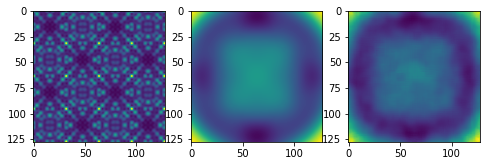

1
Log loss is:  319.0582421613971


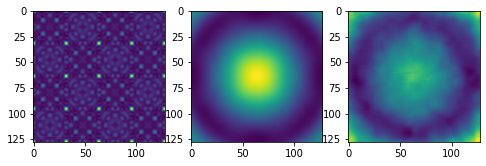

2
Log loss is:  30.15722779376903


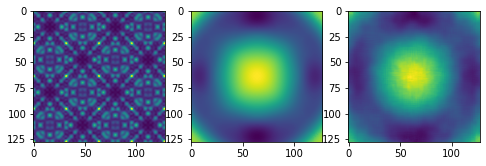

3
Log loss is:  216.61554932562032


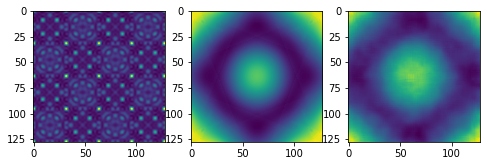

4
Log loss is:  25.07584691583041


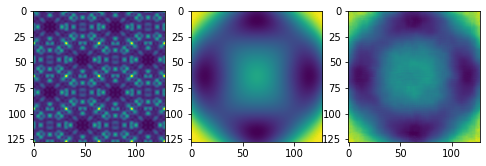

5
Log loss is:  79.02771898088132


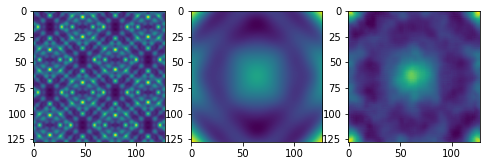

6
Log loss is:  89.53902370646244


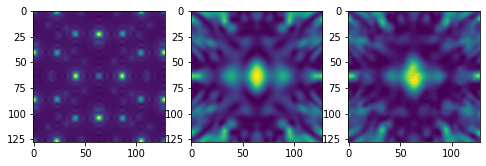

7
Log loss is:  185.38671797146907


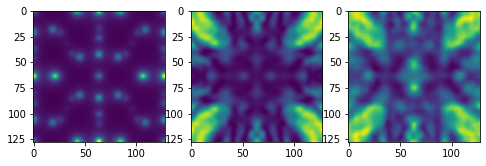

8
Log loss is:  23.120186897582155


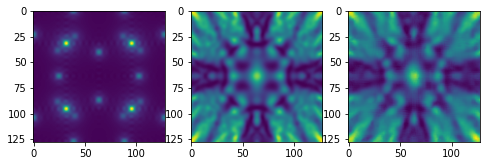

9
Log loss is:  35.241188449147934


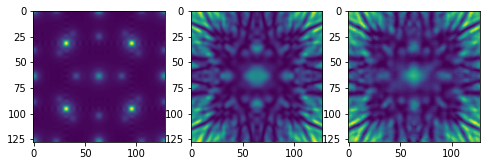

10
Log loss is:  446.9364706445168


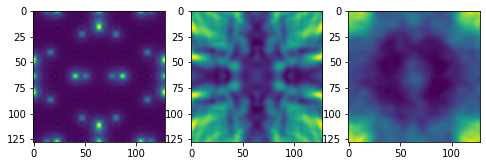

11
Log loss is:  147.47765208784205


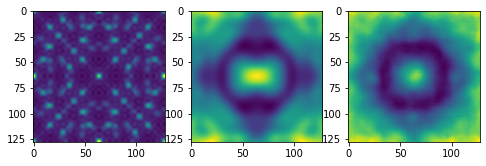

12
Log loss is:  61.814580085341845


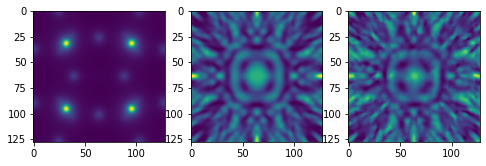

13
Log loss is:  31.497992929206422


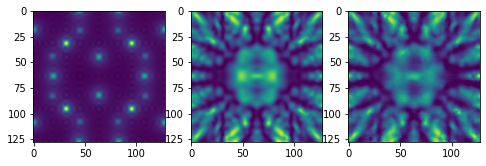

14
Log loss is:  51.62239769848086


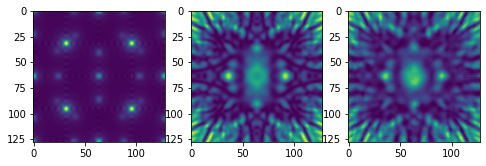

15
Log loss is:  13.224917827166829


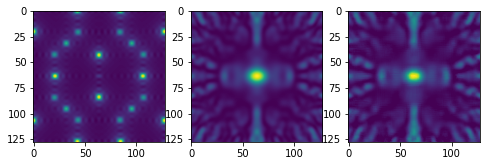

16
Log loss is:  97.57197673554703


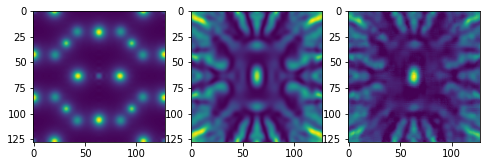

17
Log loss is:  25.417386284728096


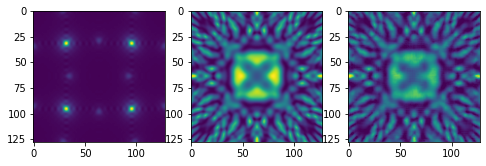

18
Log loss is:  8.428461739177605


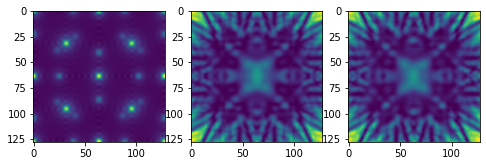

19
Log loss is:  5.047151273096348


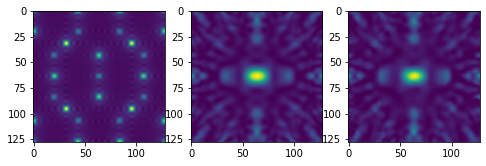

20
Log loss is:  126.3584562165564


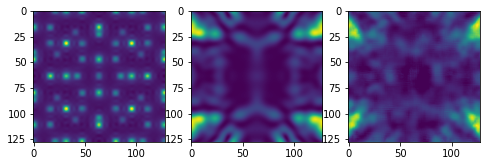

21
Log loss is:  8.238475301099122


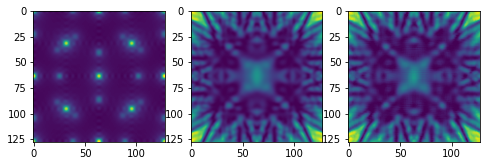

22
Log loss is:  93.68885680850393


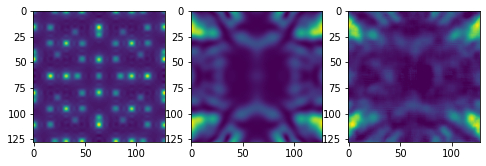

23
Log loss is:  84.2472042414998


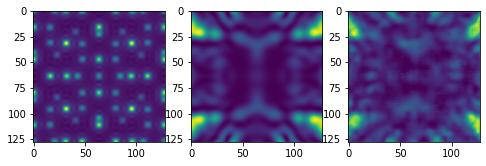

24
Log loss is:  8.463240445068115


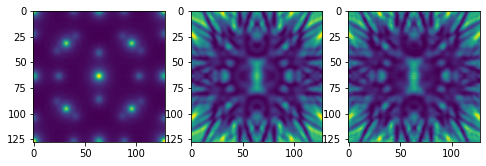

25
Log loss is:  11.518203130182608


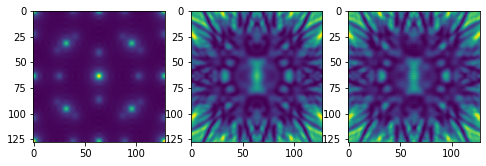

26
Log loss is:  30.595076547809146


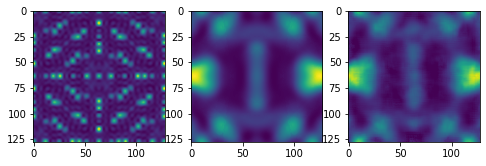

27
Log loss is:  12.012307032996352


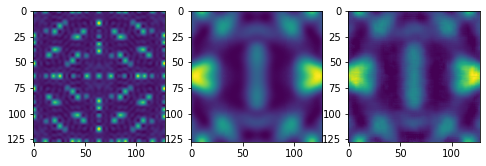

28
Log loss is:  741.0356001705788


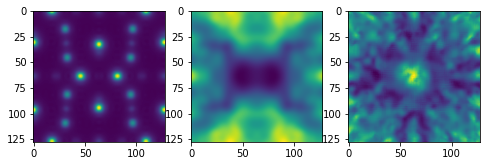

29
Log loss is:  35.62924769229094


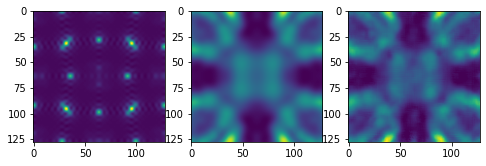

30
Log loss is:  9.987958420676472


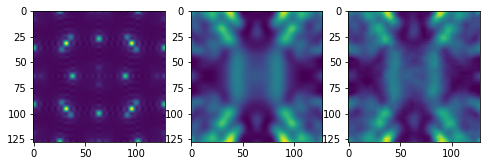

31
Log loss is:  77.74741646139678


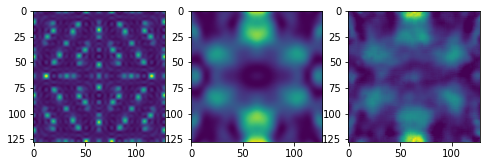

32
Log loss is:  12.233967159050696


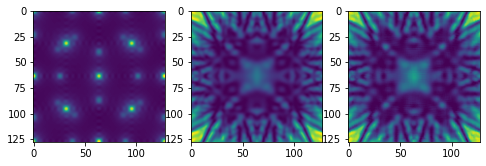

33
Log loss is:  18.024687290348027


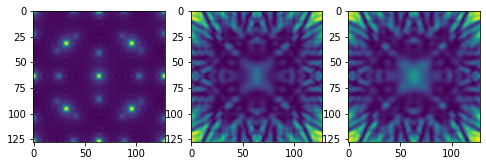

34
Log loss is:  31.597020625053794


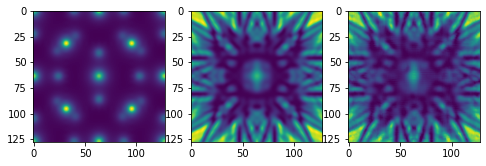

35
Log loss is:  10.119617130603048


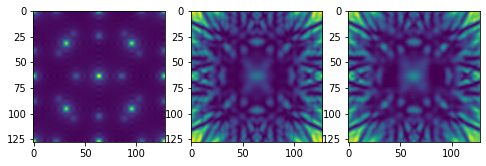

36
Log loss is:  7.774198251254826


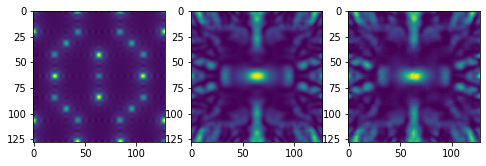

37
Log loss is:  417.5235483558088


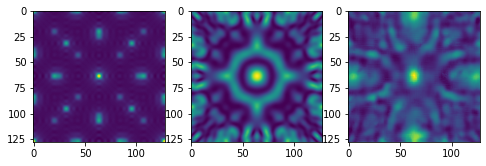

38
Log loss is:  17.71026867840766


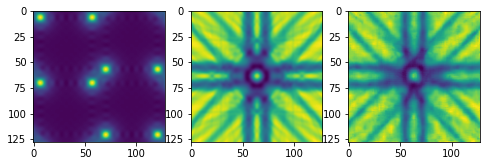

39
Log loss is:  428.6068564049193


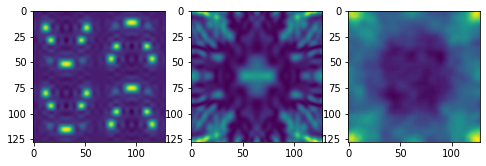

40
Log loss is:  71.07872072421483


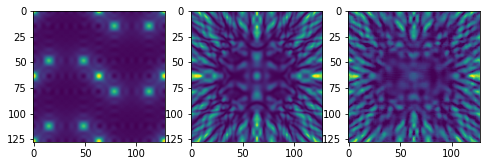

41
Log loss is:  52.45642176786004


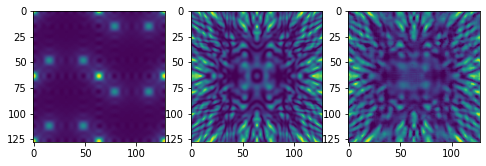

42
Log loss is:  249.19225721637474


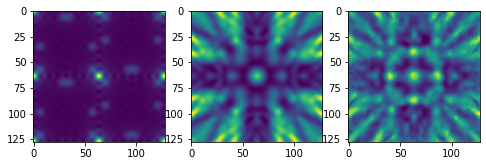

43
Log loss is:  15.655846754040118


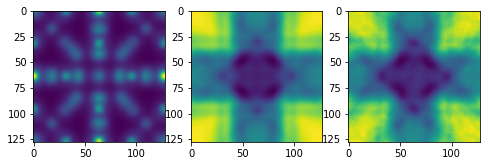

44
Log loss is:  12.634371844810612


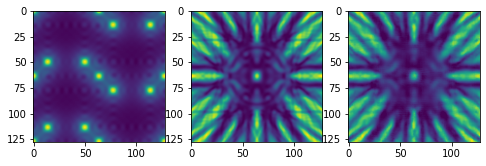

45
Log loss is:  15.55446055614881


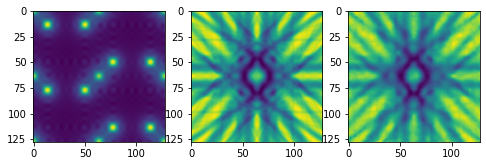

46
Log loss is:  164.27504718846458


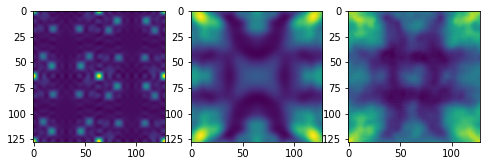

47
Log loss is:  72.7582648587144


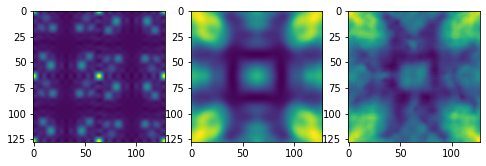

48
Log loss is:  22.930478320889208


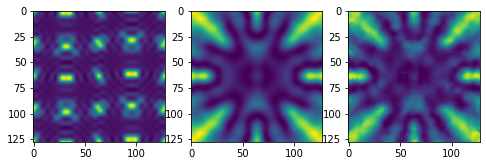

49
Log loss is:  8.719973597316214


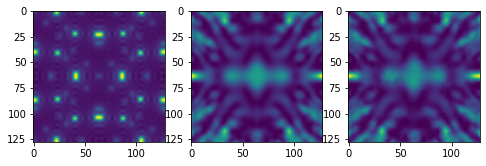

50
Log loss is:  18.27507270041999


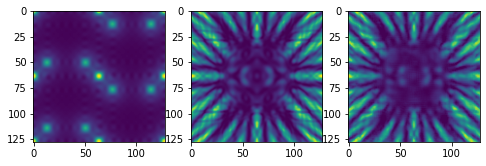

51
Log loss is:  49.348264823298905


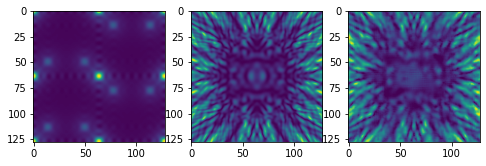

52
Log loss is:  68.23403289117489


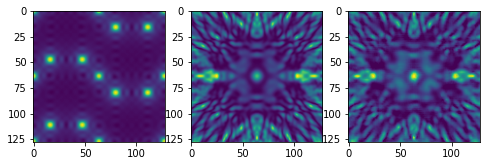

53
Log loss is:  55.986744180005104


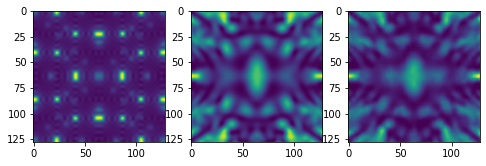

54
Log loss is:  19.379000062080113


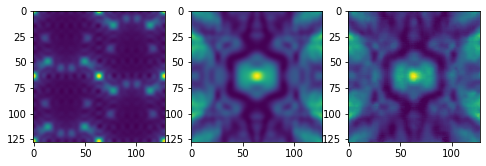

55
Log loss is:  347.84705124229197


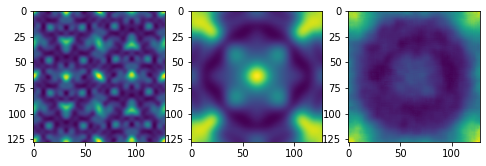

56
Log loss is:  79.37762325112728


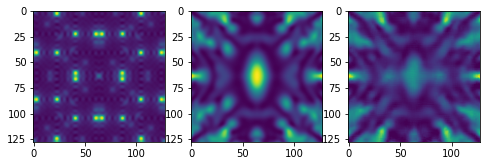

57
Log loss is:  18.675409697285897


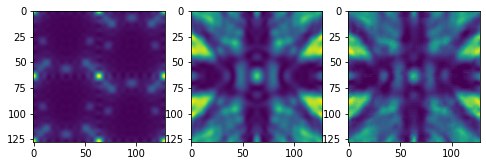

58
Log loss is:  59.89809167787701


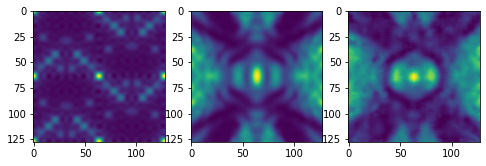

59
Log loss is:  51.43746826233692


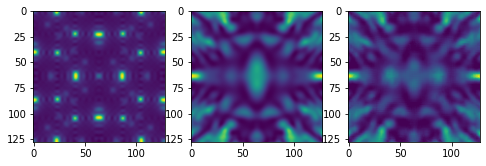

60
Log loss is:  10.764387781926894


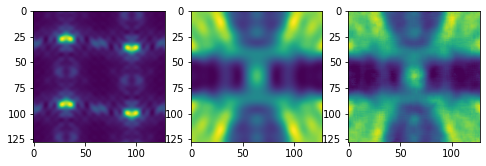

61
Log loss is:  47.77012008047669


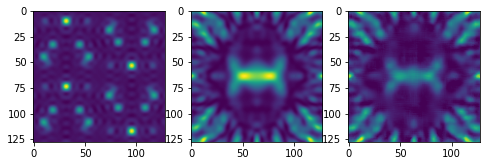

62
Log loss is:  49.643943095519084


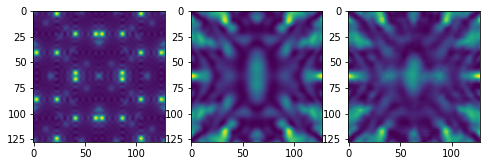

63
Log loss is:  902.7727252785451


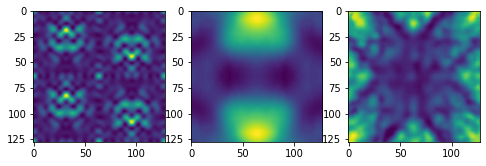

64
Log loss is:  95.41982444825459


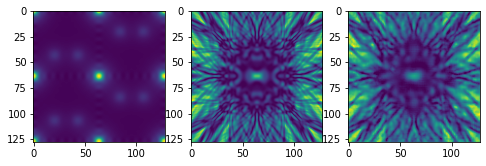

65
Log loss is:  29.394194235860798


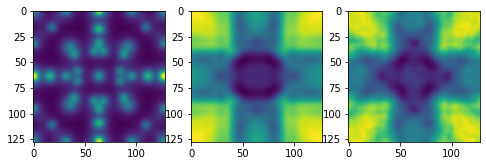

66
Log loss is:  693.6894673947651


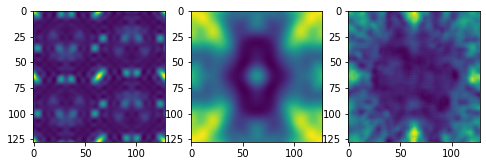

67
Log loss is:  89.8506136636743


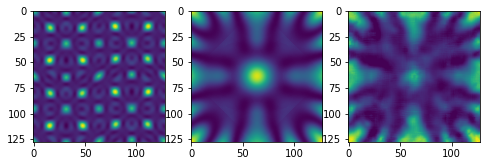

68
Log loss is:  577.4910167815455


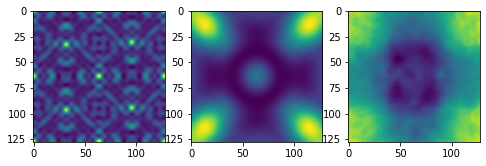

69
Log loss is:  69.32654202651473


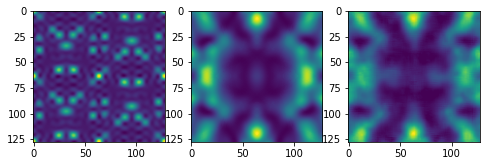

70
Log loss is:  676.8479238111911


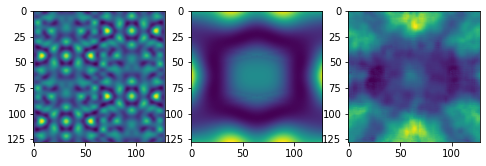

71
Log loss is:  5.554386310115058


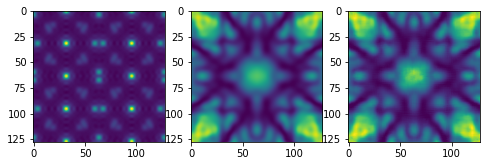

72
Log loss is:  368.6966227183838


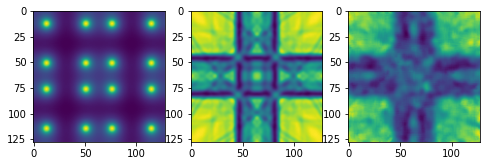

73
Log loss is:  8.321895804125546


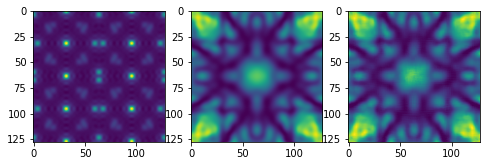

74
Log loss is:  25.700025411607484


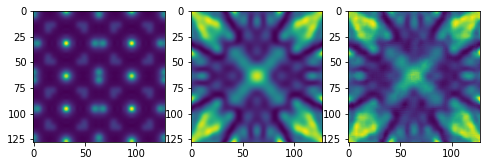

75
Log loss is:  52.86182154433101


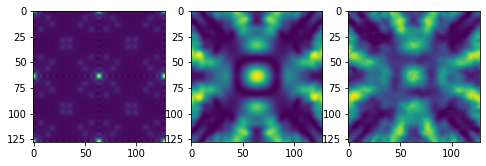

76
Log loss is:  56.57334291892825


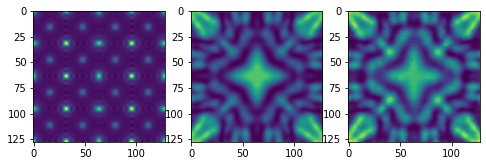

77
Log loss is:  9.010832068243202


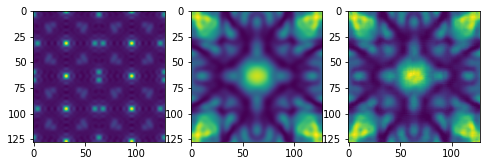

78
Log loss is:  4.2715071775386635


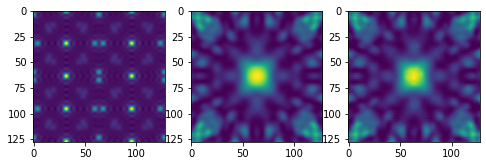

79
Log loss is:  62.77177328017517


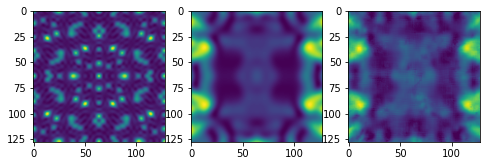

80
Log loss is:  458.3254905500947


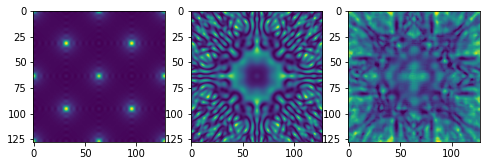

81
Log loss is:  8.612891976137753


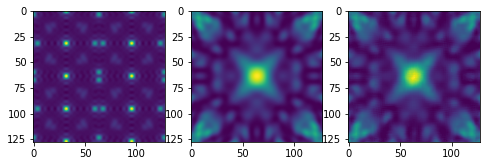

82
Log loss is:  27.42480502639819


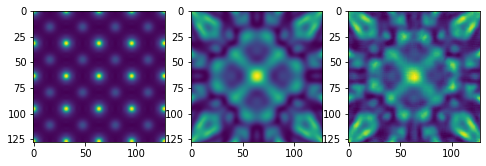

83
Log loss is:  175.04694191470023


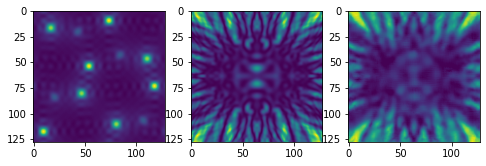

84
Log loss is:  9.45496151254384


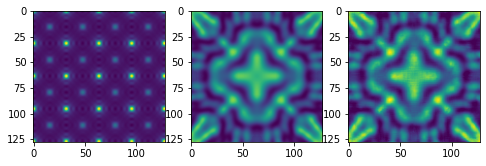

85
Log loss is:  31.92316528837957


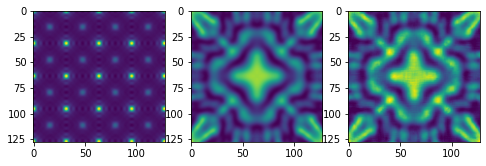

86
Log loss is:  28.656981854121348


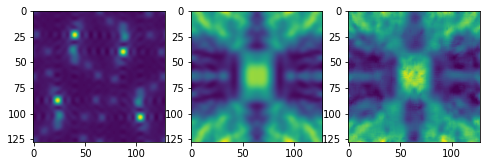

87
Log loss is:  76.81838078019943


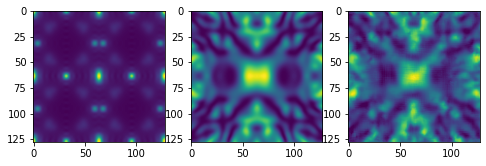

88
Log loss is:  21.68540170198315


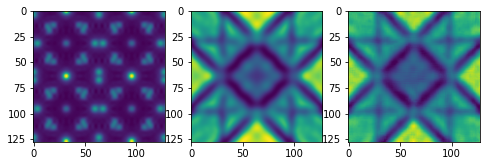

89
Log loss is:  28.845337194599015


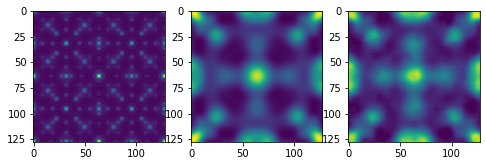

90
Log loss is:  213.62021391957364


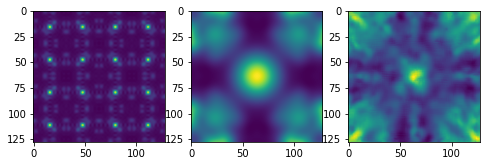

91
Log loss is:  62.431565732470965


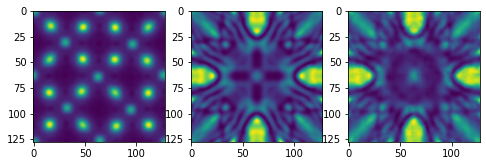

92
Log loss is:  59.01691788920483


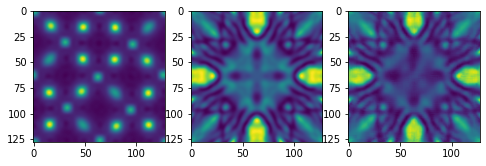

93
Log loss is:  11.742404527602998


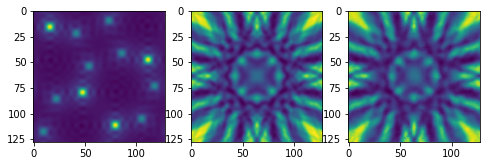

94
Log loss is:  15.637677961986508


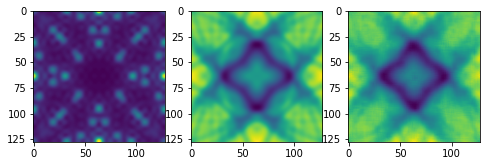

95
Log loss is:  55.99606203684687


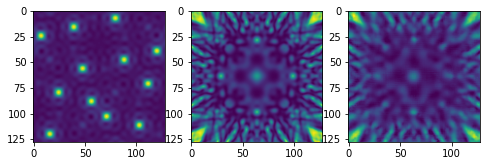

96
Log loss is:  71.51791931983536


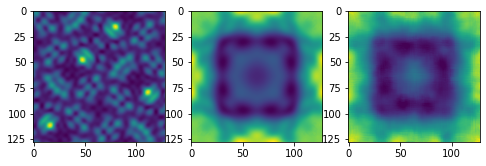

97
Log loss is:  12.952402417726562


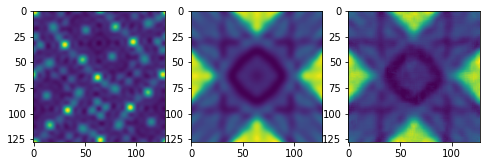

98
Log loss is:  437.5671506737986


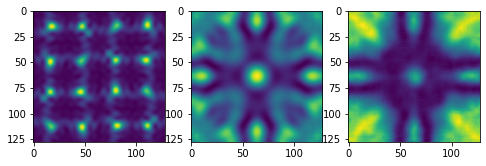

99
Log loss is:  25.62524211296961


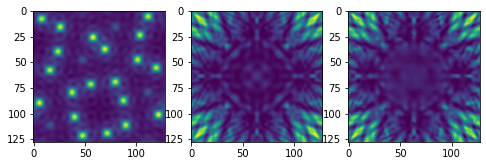

100
Log loss is:  16.076869057312184


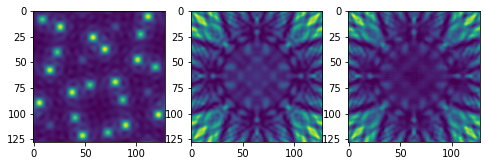

101
Log loss is:  5.86731758192813


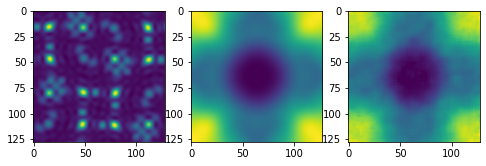

102
Log loss is:  17.454337250565306


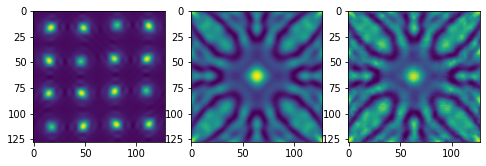

103
Log loss is:  60.436919057911076


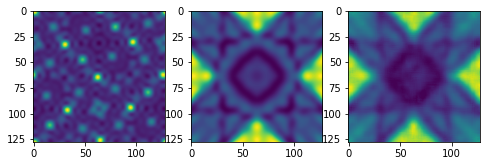

104
Log loss is:  4.083558482251707


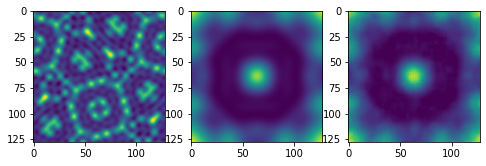

105
Log loss is:  3.633339893045741


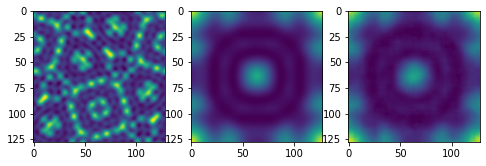

106
Log loss is:  137.79930580634218


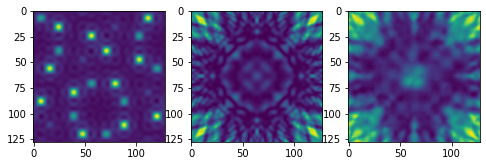

107
Log loss is:  52.978640819342814


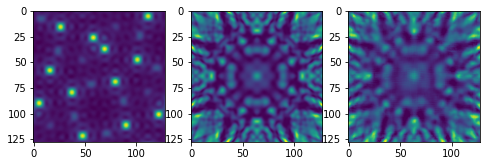

108
Log loss is:  79.25435940818572


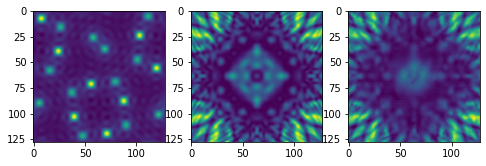

109
Log loss is:  74.92071582483746


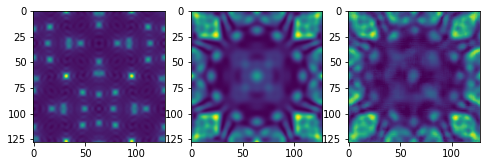

110
Log loss is:  197.7941016256406


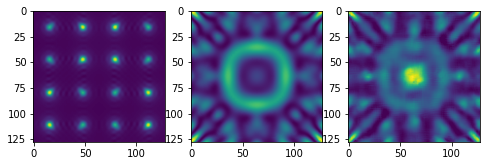

111
Log loss is:  83.49883754976364


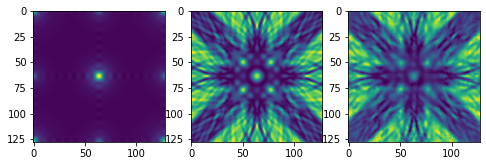

112
Log loss is:  380.3244727810708


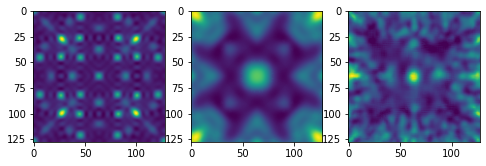

113
Log loss is:  623.9191266042308


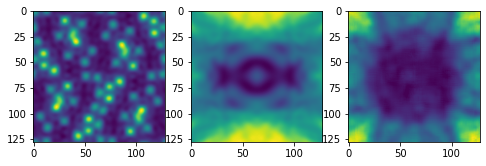

114
Log loss is:  42.88778726882067


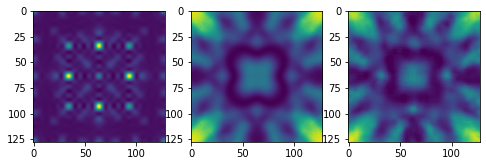

115
Log loss is:  46.45433356626261


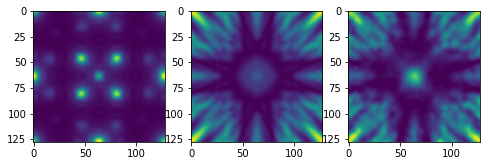

116
Log loss is:  39.42822889621602


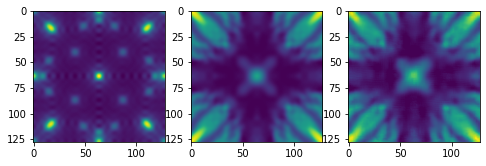

117
Log loss is:  60.715458963648636


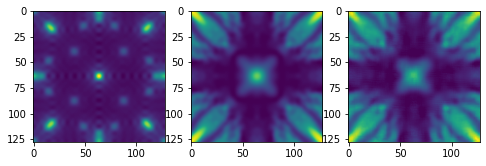

118
Log loss is:  456.0998646993441


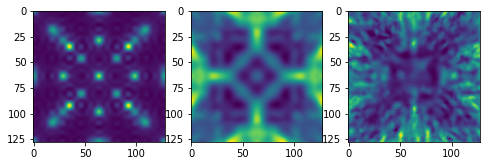

119
Log loss is:  34.90295545258402


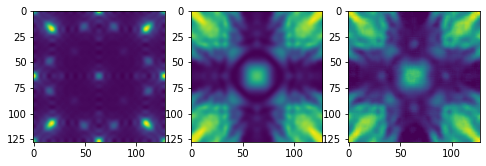

120
Log loss is:  43.53626763909446


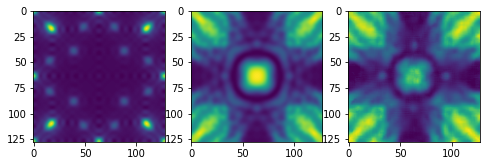

121
Log loss is:  19.85577434572829


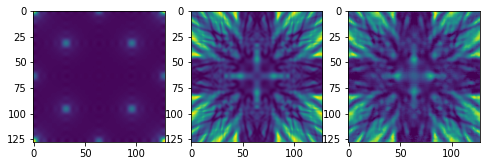

122
Log loss is:  24.20443769442608


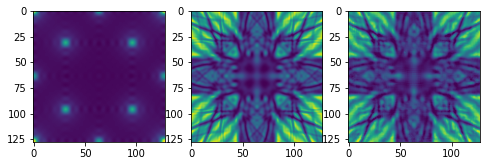

123
Log loss is:  14.272193607898394


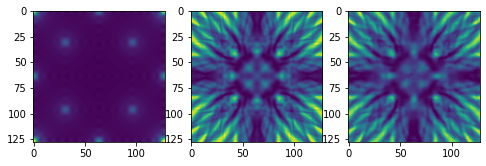

124
Log loss is:  53.22270060934434


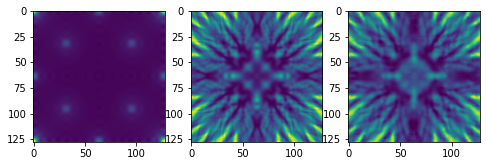

125
Log loss is:  28.36631194040513


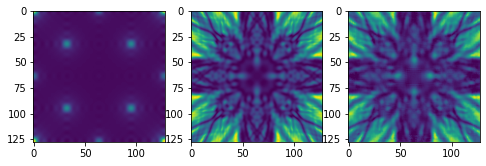

126
Log loss is:  45.007105095610385


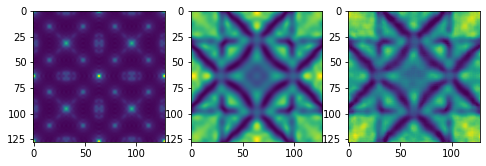

127
Log loss is:  287.39626766494797


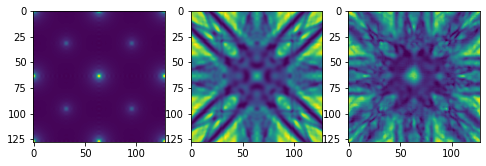

128
Log loss is:  62.95701857057163


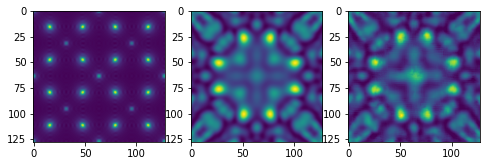

129
Log loss is:  292.7784281272675


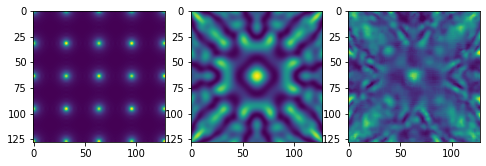

130
Log loss is:  108.78041418211421


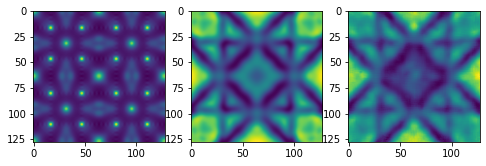

131
Log loss is:  958.9041264184484


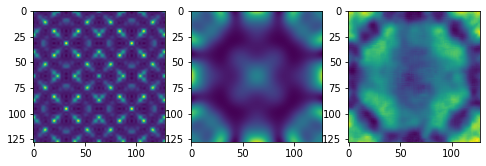

132
Log loss is:  307.12393487407354


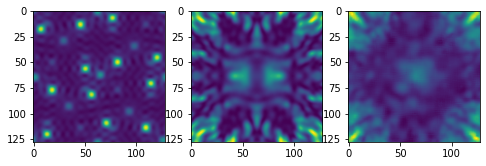

133
Log loss is:  29.357885021425304


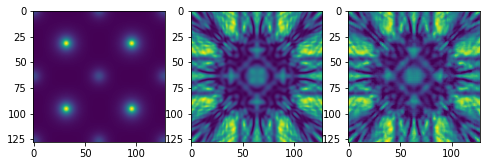

134
Log loss is:  430.4652192577236


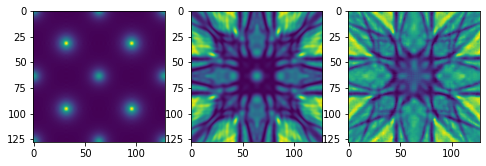

135
Log loss is:  16.28623345560849


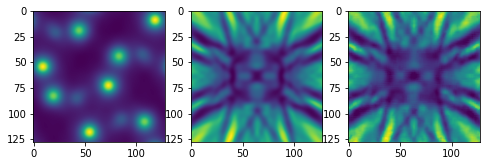

136
Log loss is:  51.17975090777688


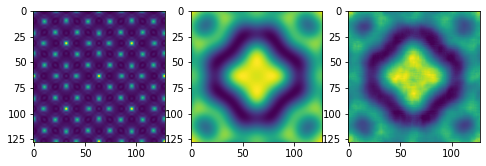

137
Log loss is:  62.16568630342628


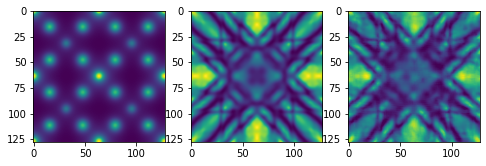

138
Log loss is:  38.2477558937895


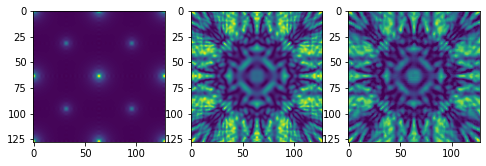

139
Log loss is:  45.464641416442085


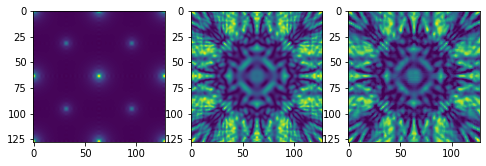

140
Log loss is:  64.30614804081591


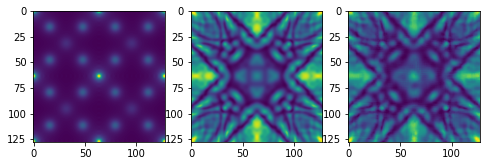

141
Log loss is:  13.265466321595753


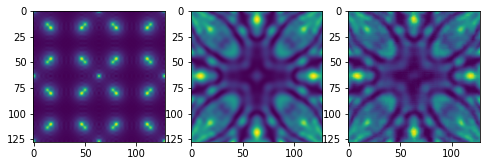

142
Log loss is:  25.49075243826232


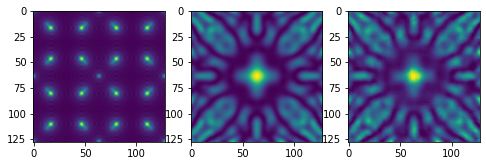

143
Log loss is:  7.514020322591554


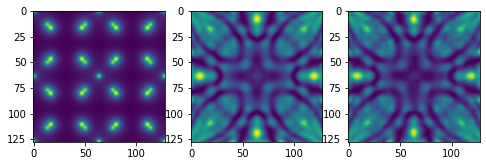

144
Log loss is:  129.96709790264725


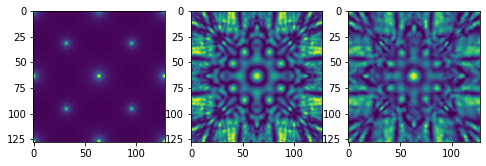

145
Log loss is:  462.909590359429


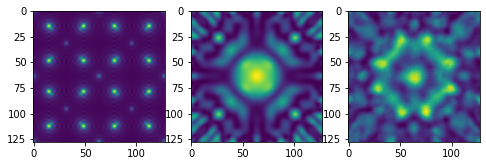

146
Log loss is:  435.19205134511463


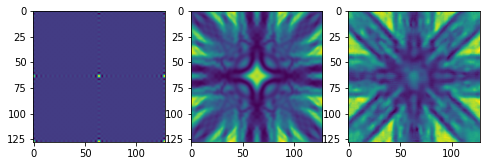

147
Log loss is:  99.67649488896535


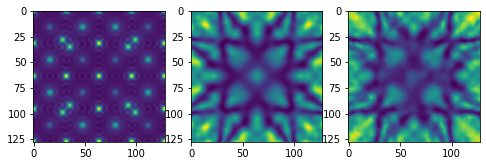

148
Log loss is:  68.3093384508841


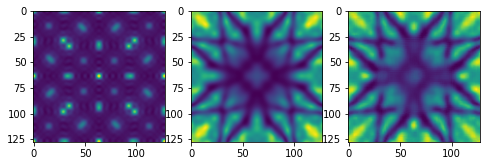

149
Log loss is:  97.05154517236043


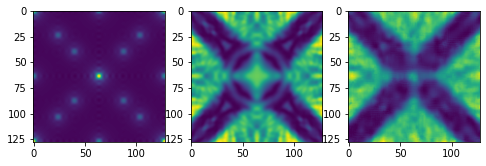

150
Log loss is:  42.09916877580883


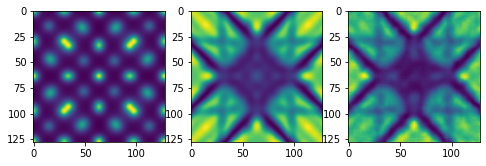

151
Log loss is:  19.910266139136752


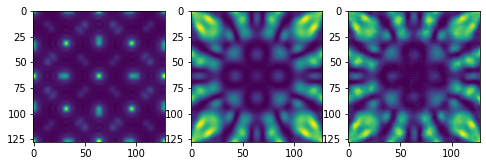

152
Log loss is:  9.999426063506784


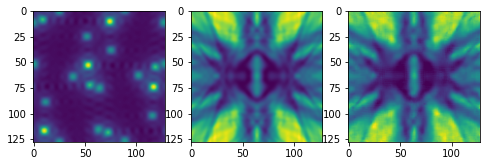

153
Log loss is:  242.2587124518897


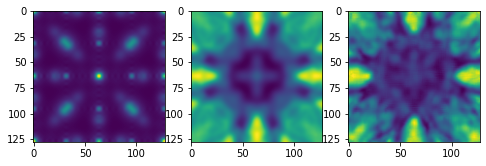

154
Log loss is:  53.343927791857844


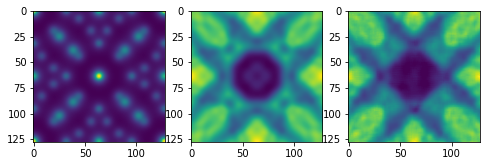

155
Log loss is:  138.02891291033754


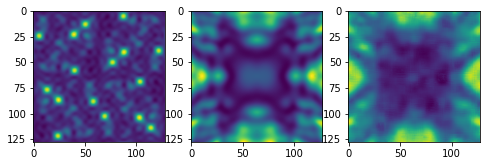

156
Log loss is:  412.91761086093396


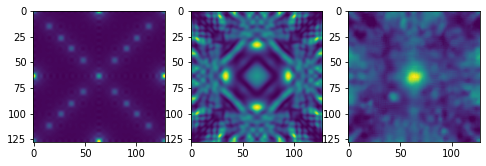

157
Log loss is:  12.96022788200956


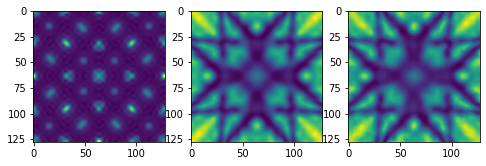

158
Log loss is:  5.785583428774763


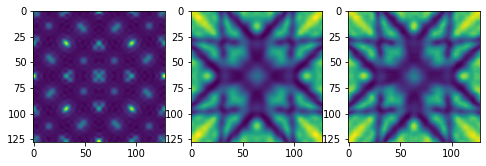

159
Log loss is:  14.448194676643562


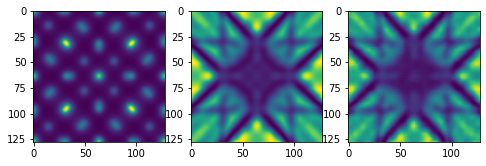

160
Log loss is:  20.492823231500175


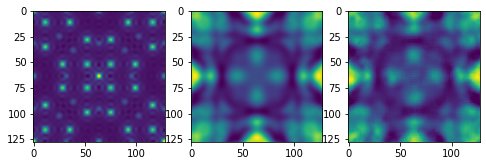

161
Log loss is:  15.954582577701265


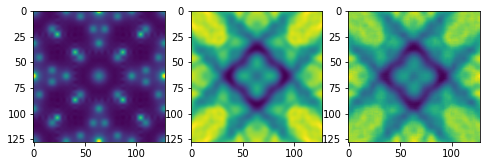

162
Log loss is:  140.59853340470065


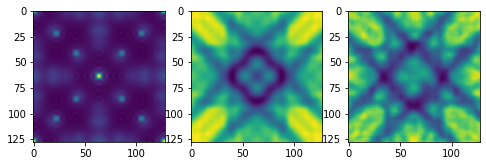

163
Log loss is:  9.879403190478273


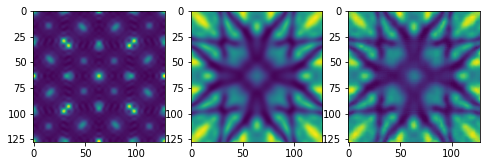

164
Log loss is:  11.274210560616055


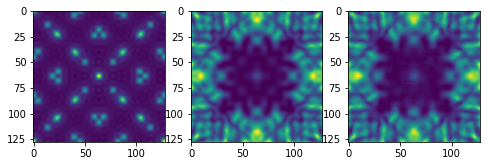

165
Log loss is:  8.50907136098188


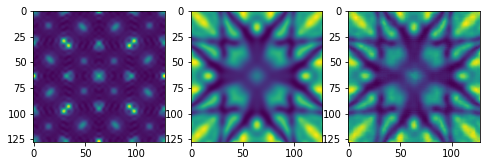

166
Log loss is:  7.17967382915871


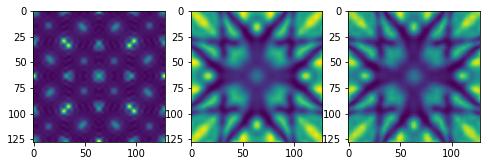

167
Log loss is:  7.2498492996509105


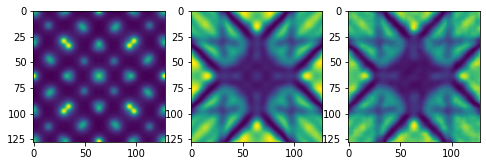

168
Log loss is:  315.96998420644377


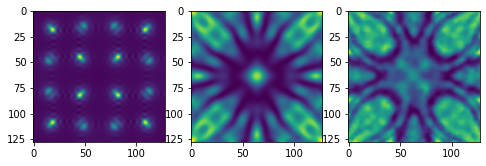

169
Log loss is:  289.121901460629


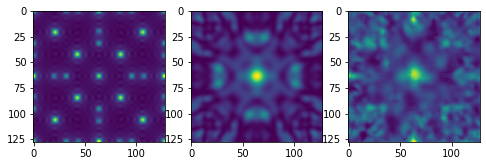

170
Log loss is:  7.528614814141519


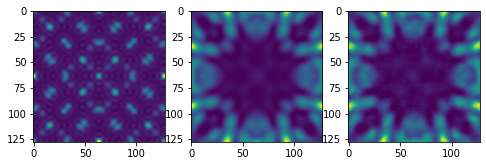

171
Log loss is:  7.832871546994667


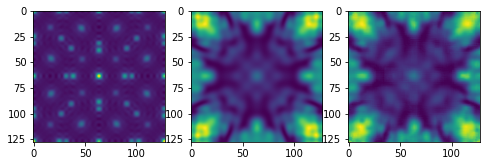

172
Log loss is:  33.131446986604146


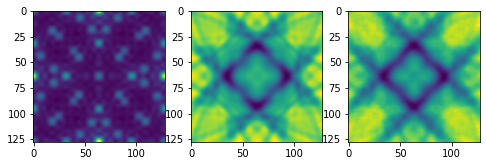

173
Log loss is:  114.42138481467356


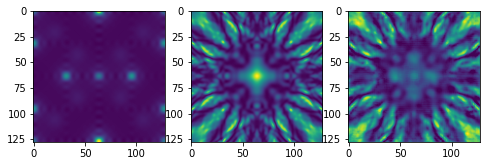

174
Log loss is:  9.76478424891862


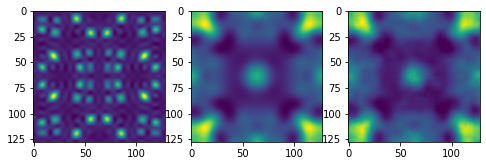

175
Log loss is:  12.399740784371563


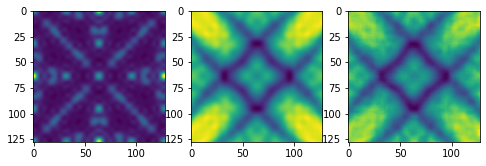

176
Log loss is:  101.3836955519639


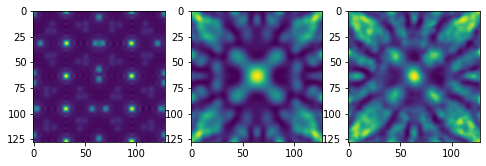

177
Log loss is:  9.884114132116865


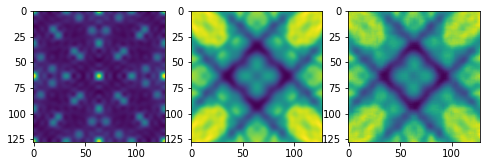

178
Log loss is:  3.5848176940243026


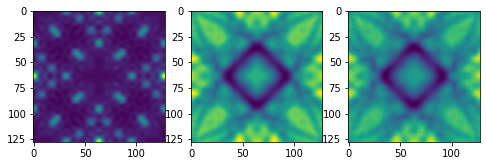

179
Log loss is:  12.853318883309472


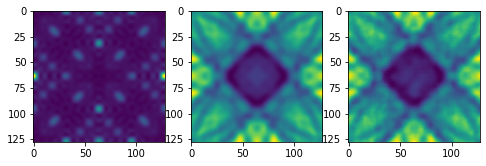

180
Log loss is:  11.6313744798717


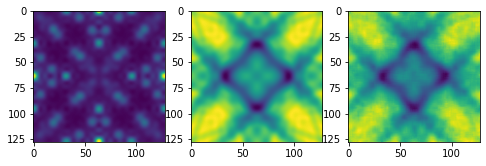

181
Log loss is:  11.628366806248646


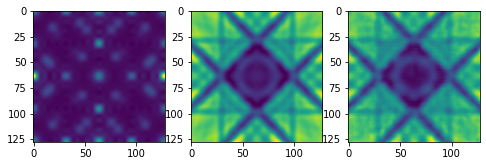

182
Log loss is:  16.7248387431857


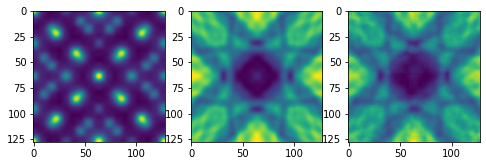

183
Log loss is:  11.309658790458236


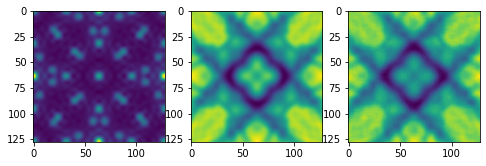

184
Log loss is:  222.76952672486976


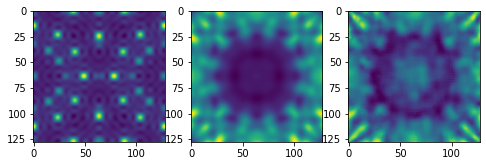

185
Log loss is:  154.81134123436198


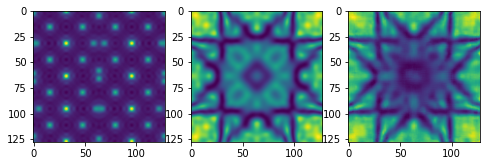

186
Log loss is:  134.1249920389556


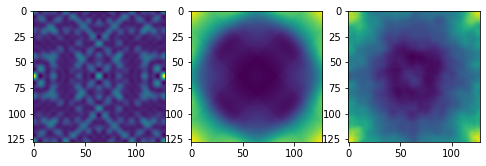

187
Log loss is:  9.47986090630255


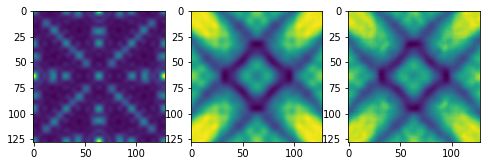

188
Log loss is:  6.837111576284629


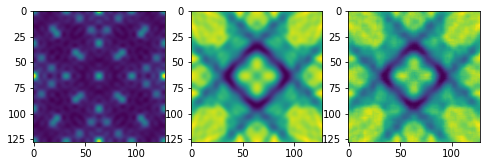

189
Log loss is:  8.557327051693385


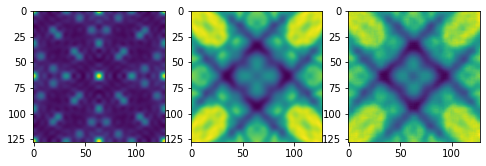

190
Log loss is:  10.55602191559581


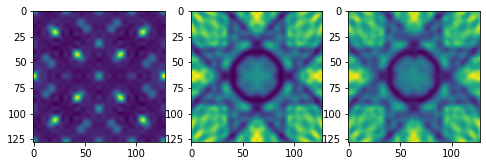

191
Log loss is:  3.0198358408461456


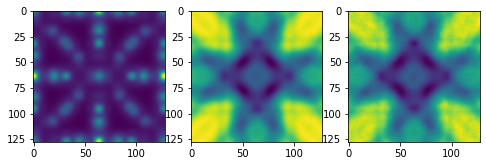

192
Log loss is:  100.07503993244148


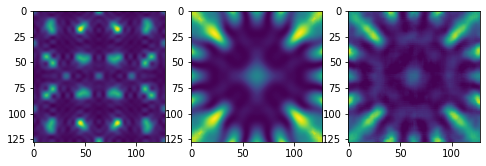

193
Log loss is:  372.3989915687571


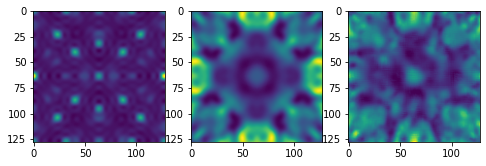

194
Log loss is:  6.9353157379154675


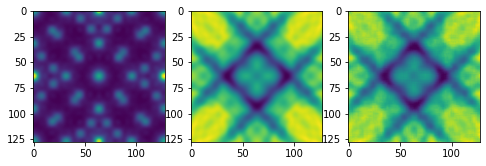

195
Log loss is:  5.3846738624137584


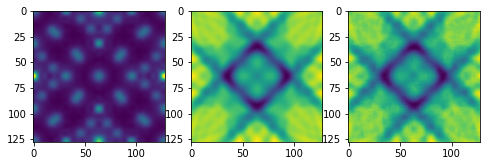

196
Log loss is:  13.807379279072839


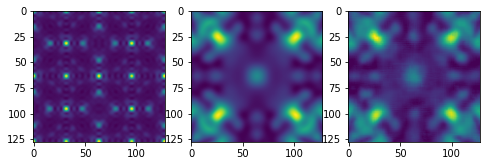

197
Log loss is:  7.020062810411108


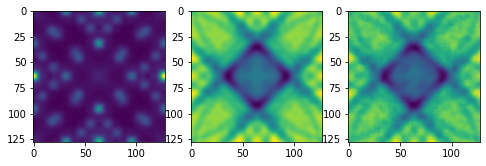

198
Log loss is:  4.848046939535715


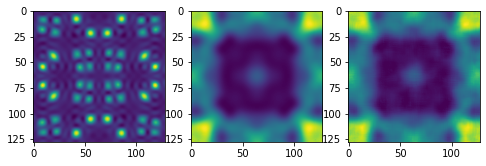

199
Log loss is:  18.15542426841464


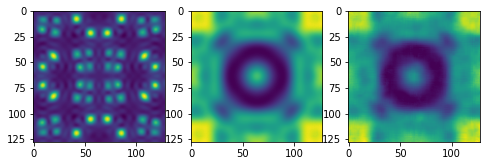

200
Log loss is:  13.858513090152265


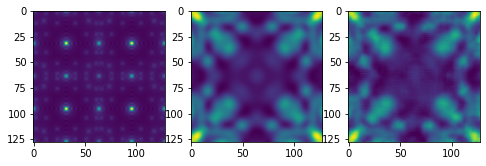

201
Log loss is:  11.517822603792148


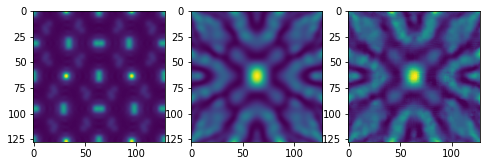

202
Log loss is:  11.813957279502427


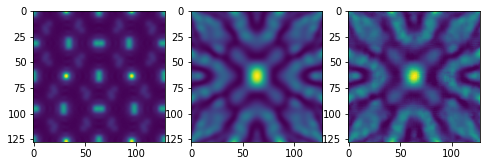

203
Log loss is:  601.8267671612435


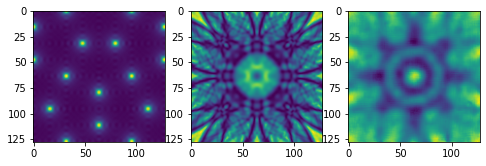

204
Log loss is:  34.16474938209529


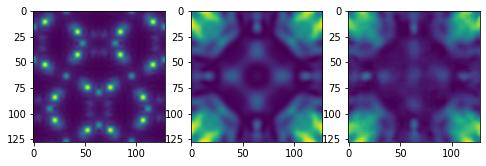

205
Log loss is:  66.01137942947356


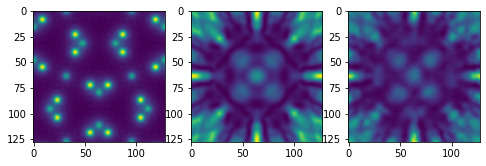

206
Log loss is:  241.2324101279626


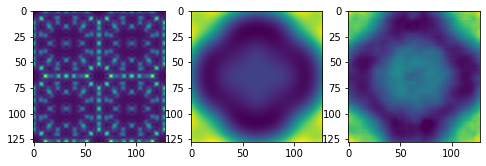

207
Log loss is:  401.62339350380563


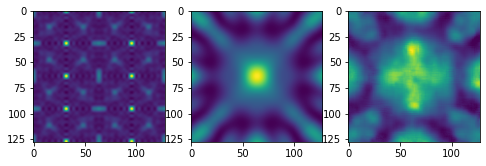

208
Log loss is:  32.57295455742835


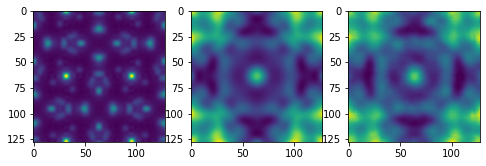

209
Log loss is:  11.681918035250744


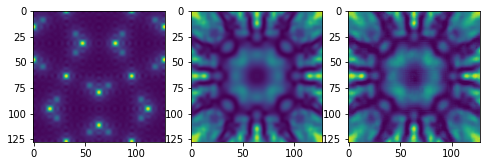

210
Log loss is:  129.15157079490893


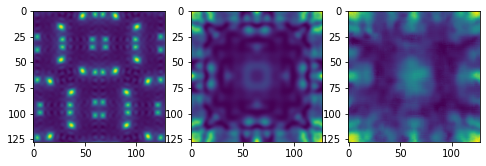

211
Log loss is:  151.6396951145875


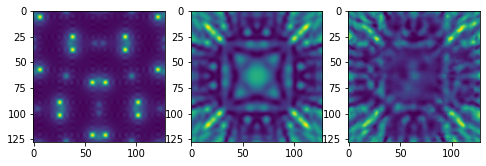

212
Log loss is:  11.761102037012321


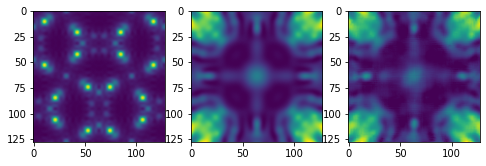

213
Log loss is:  176.65473090990395


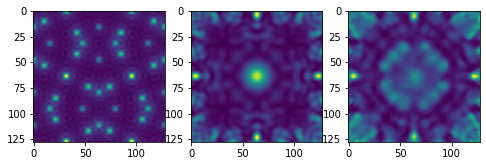

214
Log loss is:  361.12784691358394


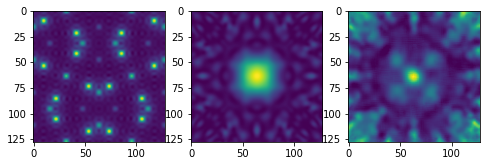

215
Log loss is:  783.9953573672262


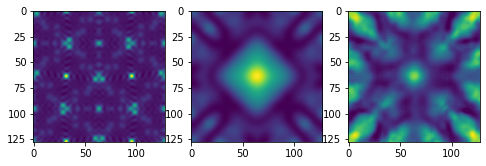

216
Log loss is:  46.68719488306299


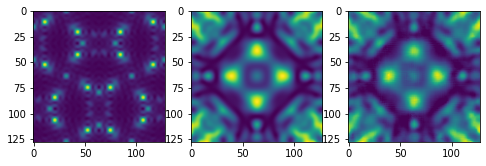

217
Log loss is:  12.675837389831756


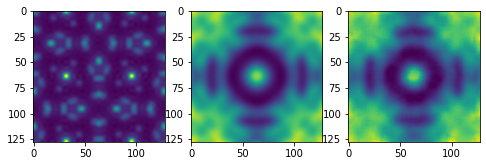

218
Log loss is:  78.38889525635685


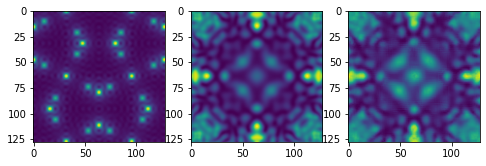

219
Log loss is:  14.271025438974428


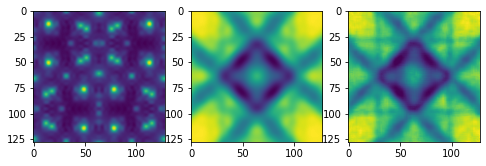

220
Log loss is:  174.6614234783442


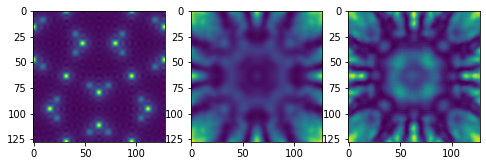

221
Log loss is:  197.7195980898698


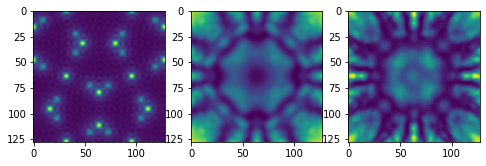

222
Log loss is:  846.2697590571971


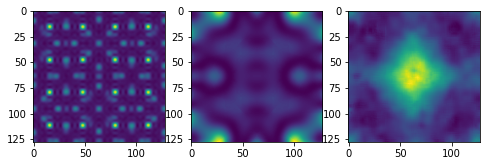

223
Log loss is:  84.35343099155875


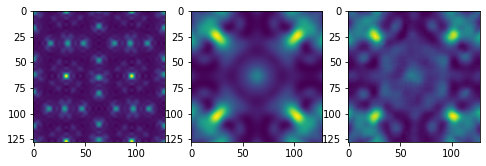

224
Log loss is:  15.131003158404331


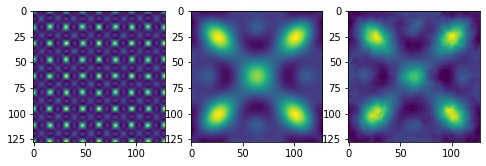

225
Log loss is:  20.72985584318765


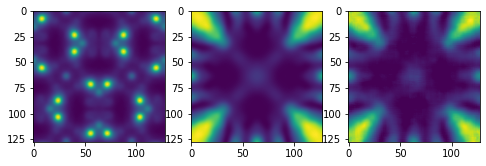

226
Log loss is:  298.7199055824061


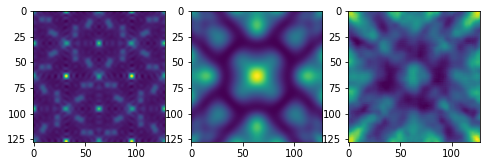

227
Log loss is:  37.22075434461443


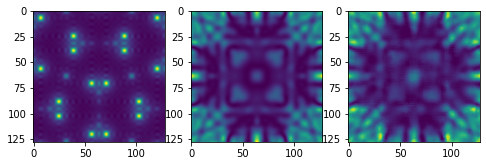

228
Log loss is:  5.432944441243197


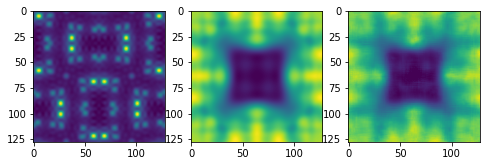

229
Log loss is:  7.889284029442221


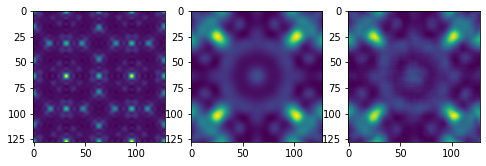

230
Log loss is:  121.04579065339831


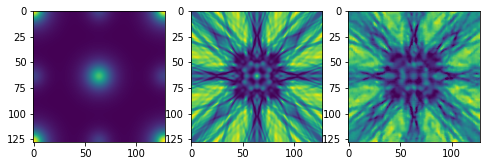

231
Log loss is:  8.555633578756677


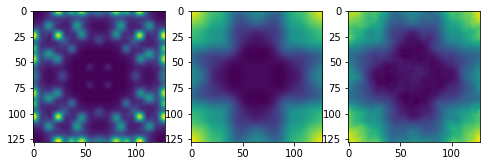

232
Log loss is:  30.70623751975435


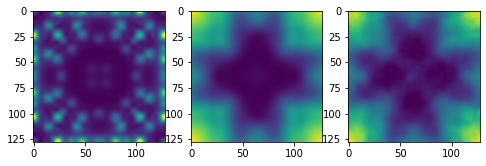

233
Log loss is:  38.60587927989668


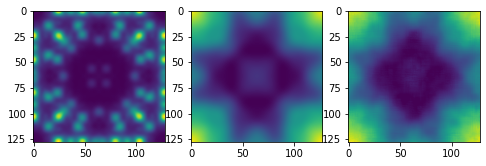

234
Log loss is:  25.742934083858596


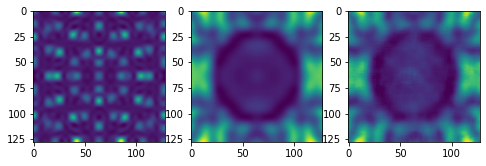

235
Log loss is:  220.68935058261363


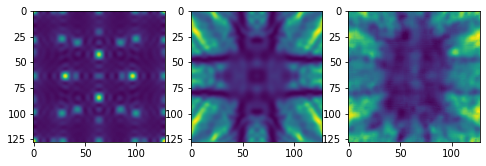

236
Log loss is:  29.503634099050757


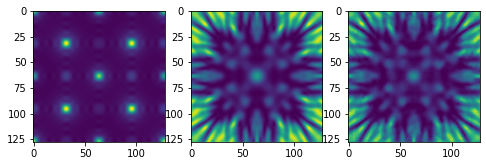

237
Log loss is:  32.20828248746415


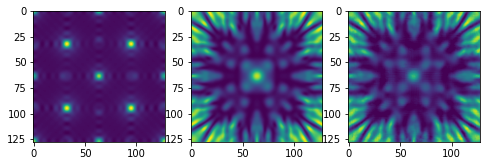

238
Log loss is:  296.4061352608348


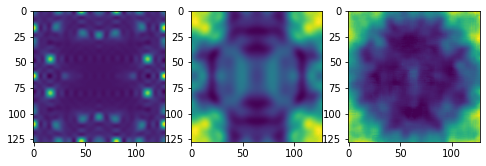

239
Log loss is:  5.71907543408185


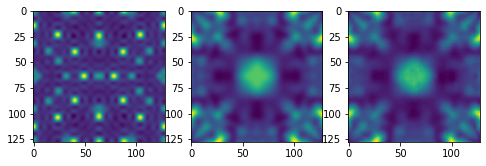

240
Log loss is:  3.443665521934756


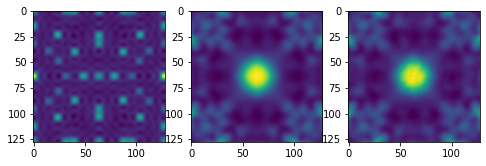

241
Log loss is:  48.403224405105234


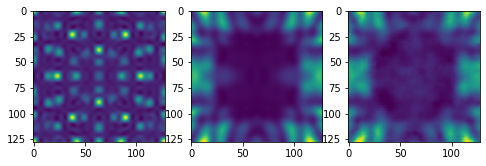

242
Log loss is:  383.0286785858771


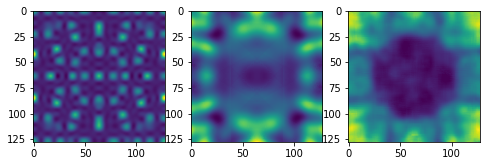

243
Log loss is:  12.05940498222714


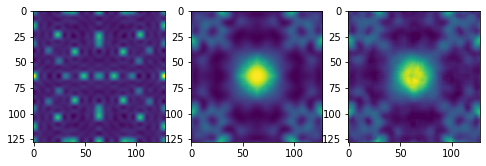

244
Log loss is:  4.300686702615365


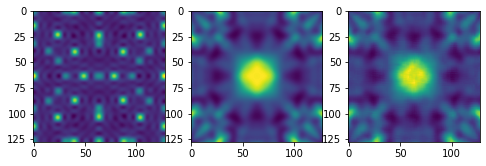

245
Log loss is:  280.36708095315686


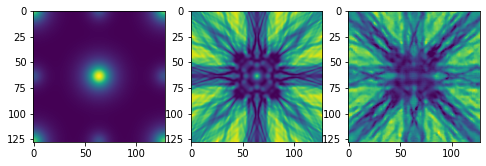

246
Log loss is:  6.106440025362055


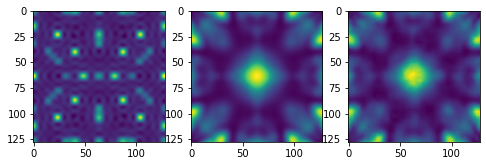

247
Log loss is:  34.36453218921005


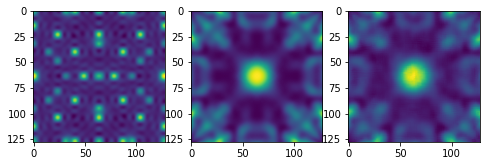

248
Log loss is:  12.622489736857302


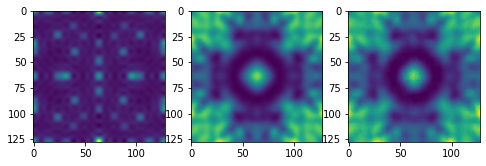

249
Log loss is:  181.3352712793101


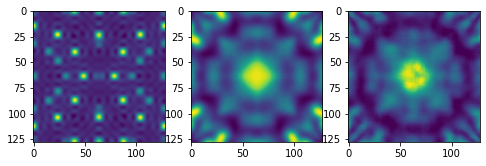

250
Log loss is:  2.9420658467069445


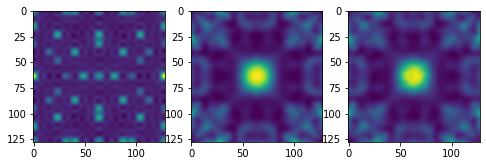

251
Log loss is:  8.46393995048989


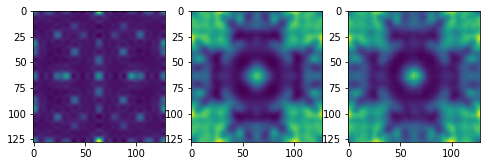

252
Log loss is:  14.8707316090595


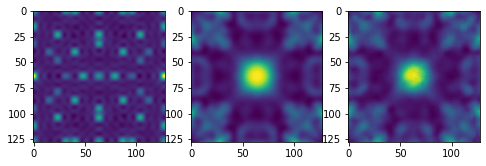

253
Log loss is:  12.541487324147429


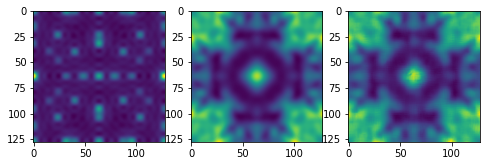

254
Log loss is:  58.48802927100639


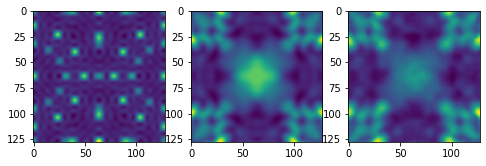

255
Log loss is:  10.81330780142173


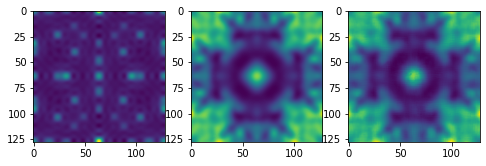

256
Log loss is:  10.144140680349567


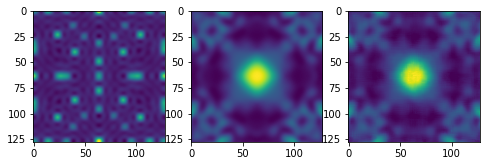

257
Log loss is:  118.4355211728698


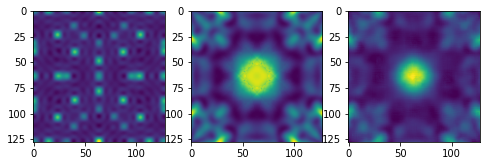

258
Log loss is:  245.64508757612867


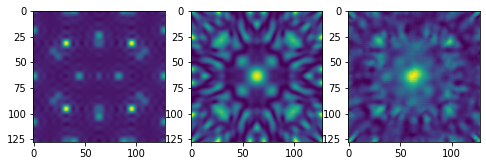

259
Log loss is:  2.9048731573904276


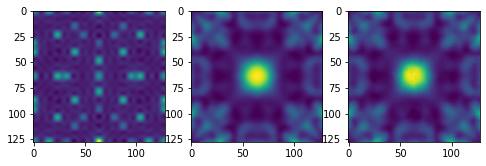

260
Log loss is:  217.4852076168937


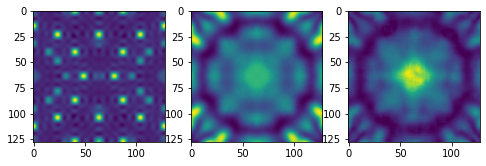

261
Log loss is:  274.96558294511647


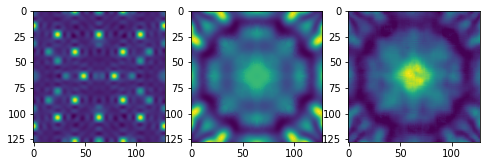

262
Log loss is:  175.05045019214455


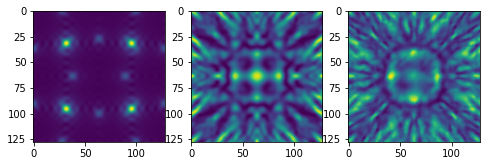

263
Log loss is:  23.95109482036198


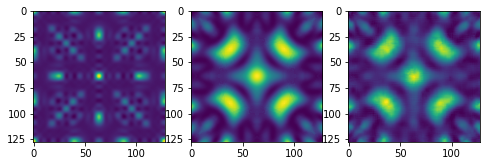

264
Log loss is:  10.24418736669799


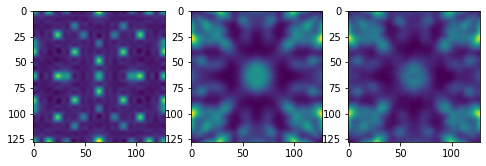

265
Log loss is:  12.30606676864427


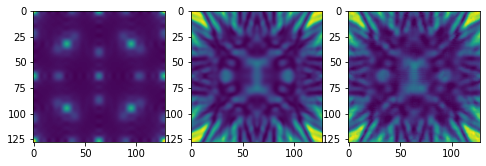

266
Log loss is:  136.9234213522895


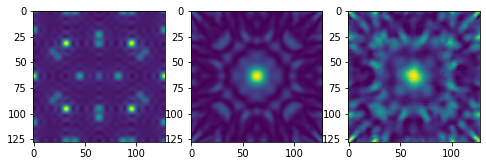

267
Log loss is:  4.06142811690515


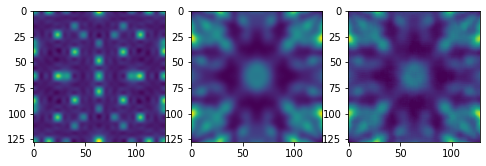

268
Log loss is:  19.287161265059634


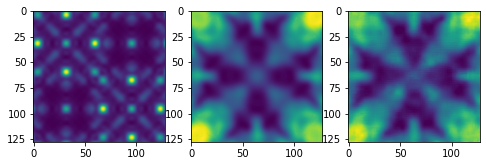

269
Log loss is:  14.42873090680788


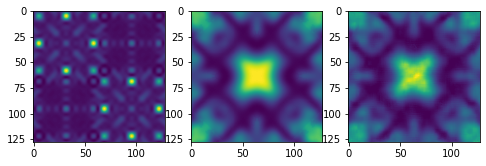

270
Log loss is:  47.037028445500844


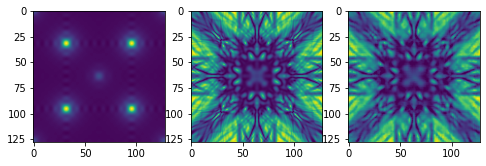

271
Log loss is:  35.17482499734669


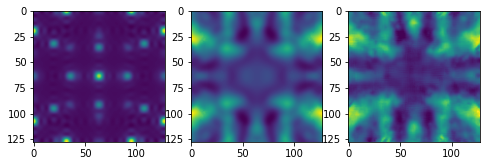

272
Log loss is:  44.39353890935412


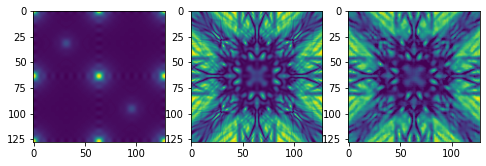

273
Log loss is:  129.43069215068135


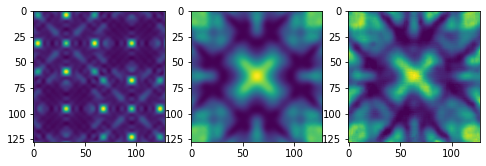

274
Log loss is:  179.34772106094903


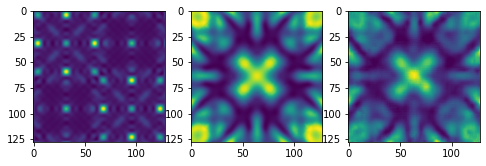

275
Log loss is:  611.599746770214


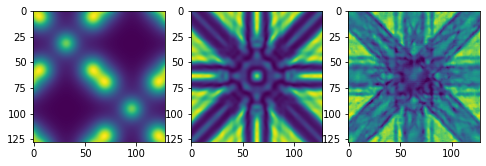

276
Log loss is:  63.511794646038396


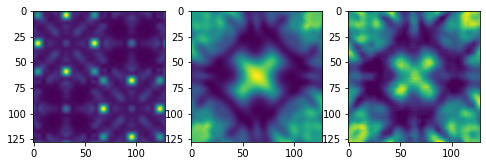

277
Log loss is:  22.10526845087406


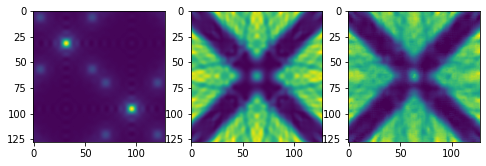

278
Log loss is:  40.655756424661014


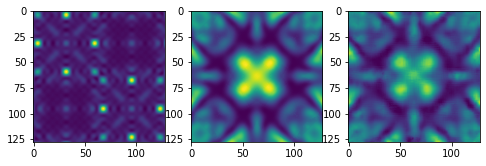

279
Log loss is:  284.8012283214297


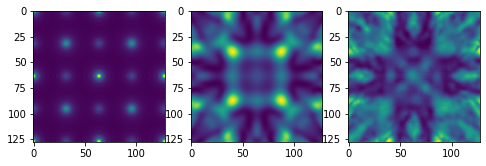

280
Log loss is:  20.8303232786696


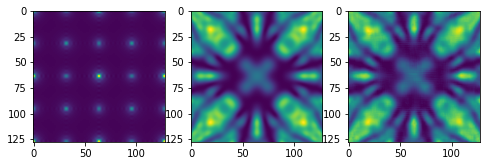

281
Log loss is:  227.6347193303217


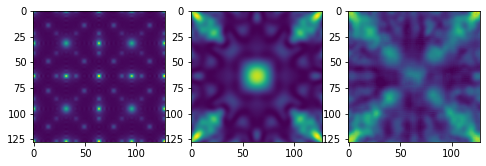

282
Log loss is:  43.859126916008414


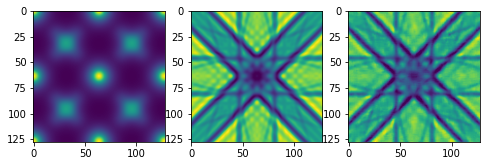

283
Log loss is:  50.85259696611261


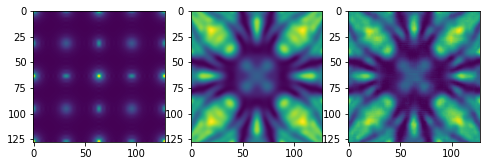

284
Log loss is:  457.7650462951231


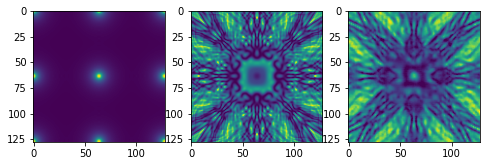

285
Log loss is:  29.960849886760435


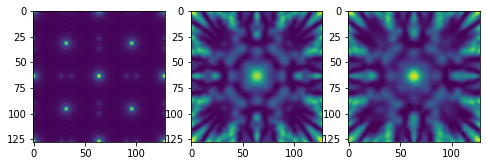

286
Log loss is:  70.93291868018133


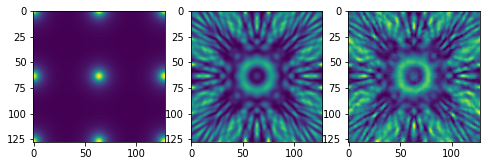

287
Log loss is:  116.82013968760006


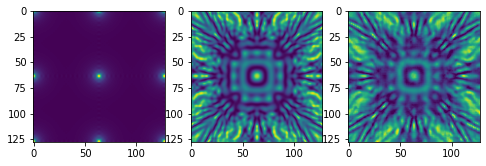

288
Log loss is:  11.590880350573688


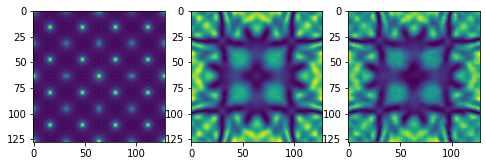

289
Log loss is:  79.23201403607472


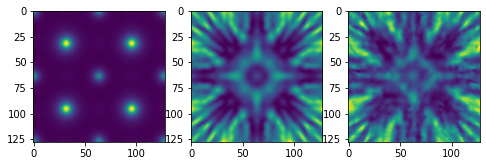

290
Log loss is:  645.6606042264384


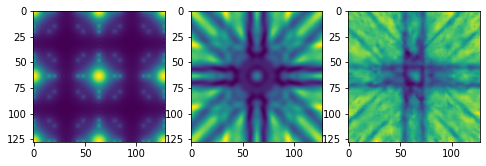

291
Log loss is:  122.80577892335944


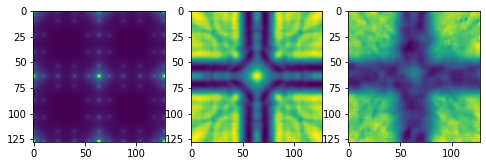

292
Log loss is:  44.537630025825806


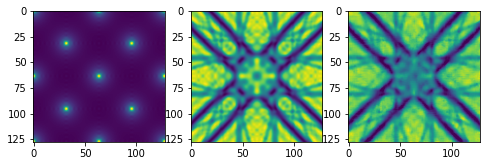

293
Log loss is:  38.96817319671618


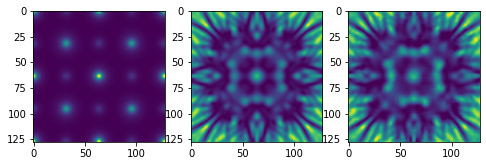

294
Log loss is:  29.66874198239978


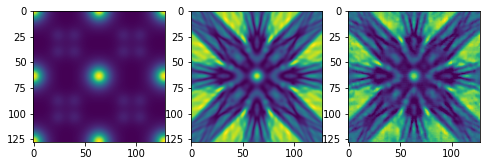

295
Log loss is:  14.149093582256063


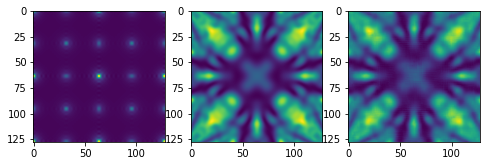

296
Log loss is:  106.61484397484202


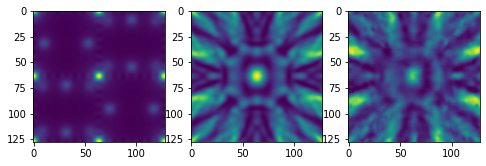

297
Log loss is:  105.48390636318015


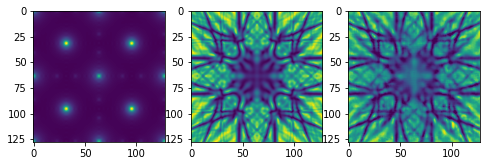

298
Log loss is:  28.495508145524923


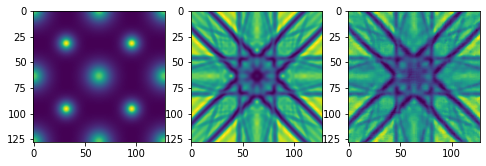

299
Log loss is:  95.95482471396544


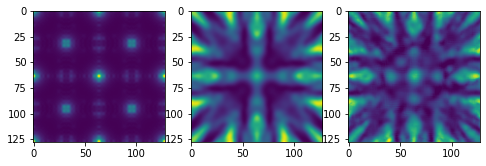

300
Log loss is:  30.10246538429543


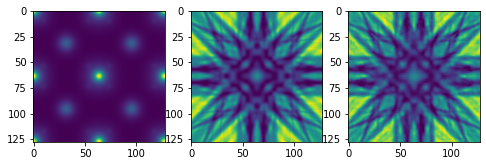

301
Log loss is:  32.68310997989771


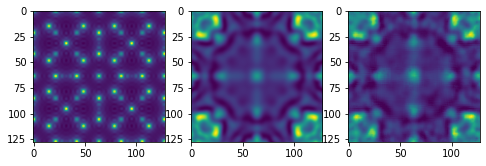

302
Log loss is:  58.88414015737484


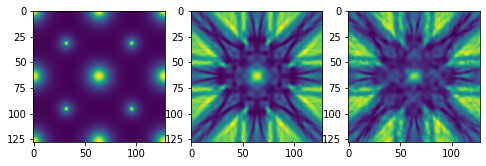

303
Log loss is:  285.45787604318167


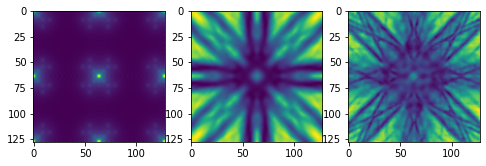

304
Log loss is:  19.955471327046112


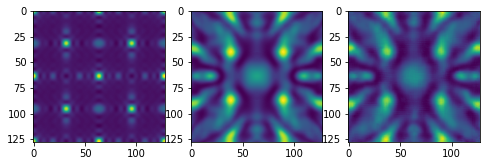

305
Log loss is:  18.181904628055424


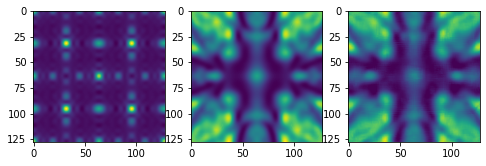

306
Log loss is:  152.22106853761503


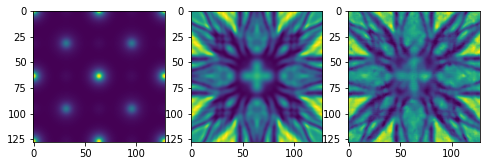

307
Log loss is:  41.705300564171445


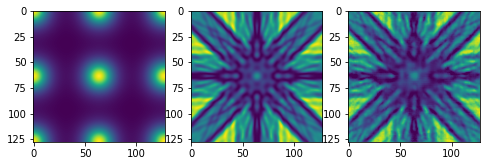

308
Log loss is:  69.47568936843703


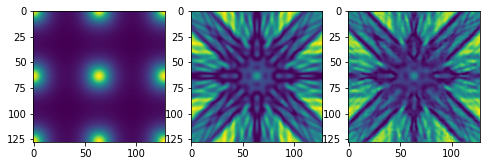

309
Log loss is:  256.7208032094735


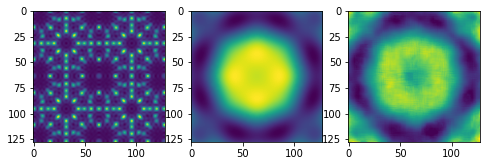

310
Log loss is:  325.78337918593013


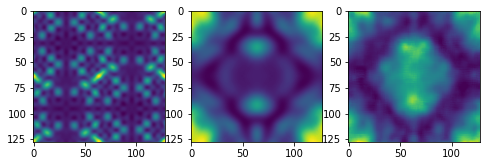

311
Log loss is:  26.51703277814823


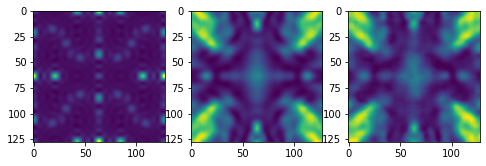

312
Log loss is:  21.085801941382016


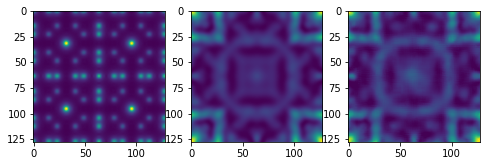

313
Log loss is:  9.903115516293107


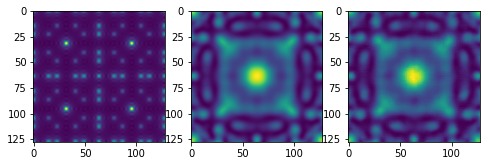

314
Log loss is:  22.154433242432518


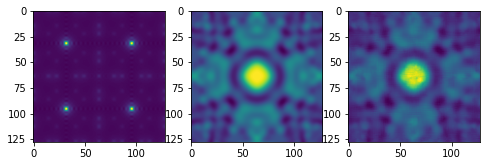

315
Log loss is:  28.73958571535705


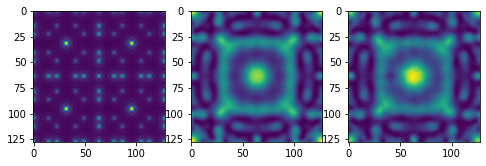

316
Log loss is:  430.18170958495426


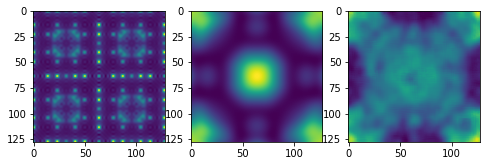

317
Log loss is:  241.16994891823865


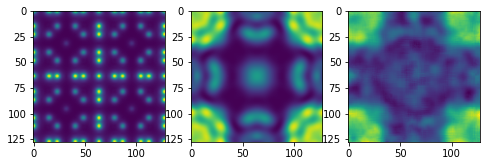

318
Log loss is:  13.490338068343185


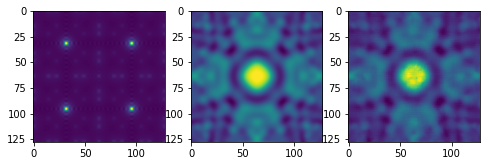

319
Log loss is:  25.079225402197466


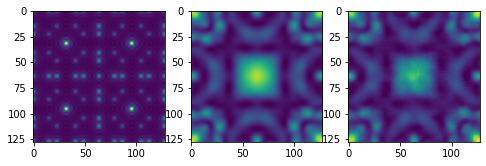

320
Log loss is:  4.630753670569787


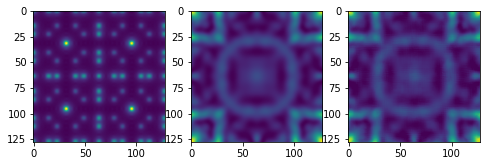

321
Log loss is:  4.13448374304792


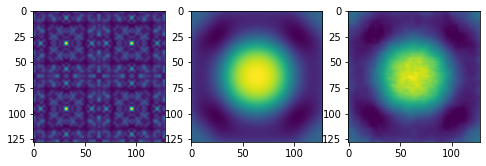

322
Log loss is:  25.999847450295736


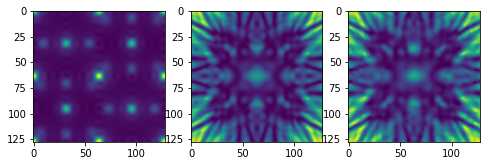

323
Log loss is:  72.08246202279835


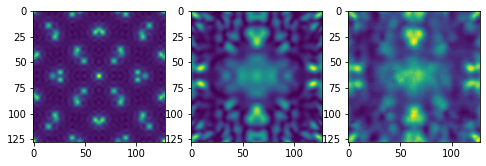

324
Log loss is:  21.442862502681084


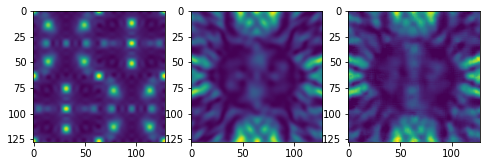

325
Log loss is:  39.81934925114852


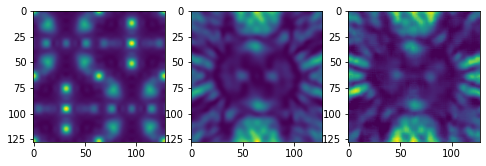

326
Log loss is:  210.37550408052243


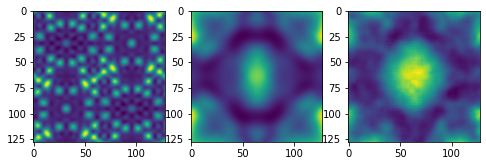

327
Log loss is:  47.33126925297959


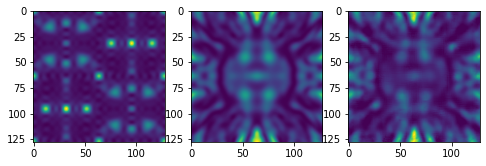

328
Log loss is:  662.2765890786635


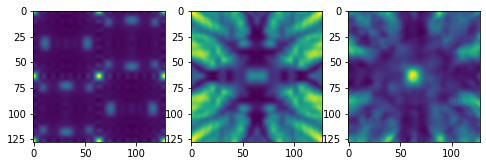

329
Log loss is:  237.26933885567323


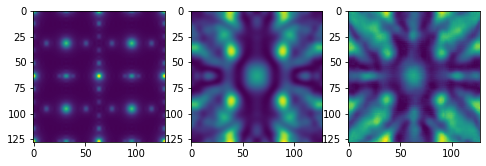

330
Log loss is:  89.52007539726982


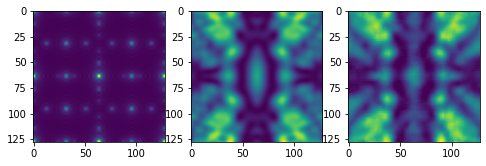

331
Log loss is:  135.22847406496294


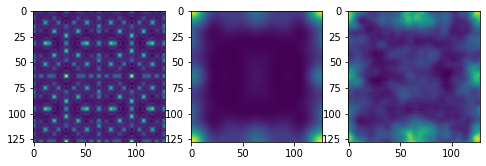

332
Log loss is:  11.23625997691173


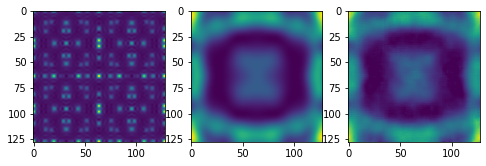

333
Log loss is:  18.309942769319747


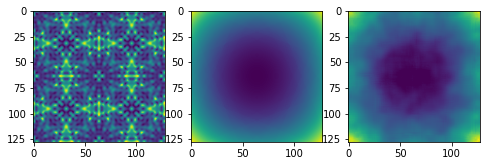

334
Log loss is:  25.69525022984168


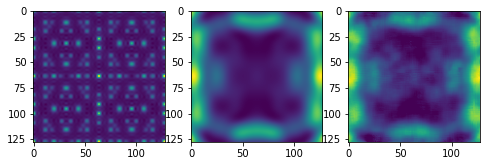

335
Log loss is:  229.466814649764


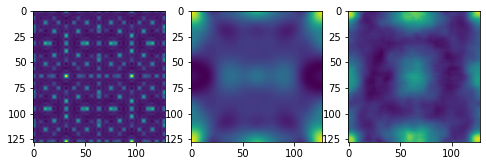

336
Log loss is:  1070.1591943801795


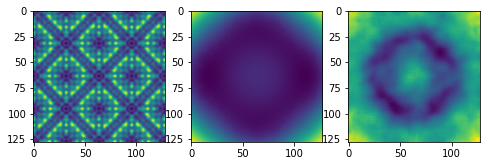

337
Log loss is:  19.573187005547172


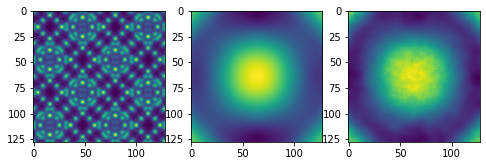

338
Log loss is:  36.67917574358234


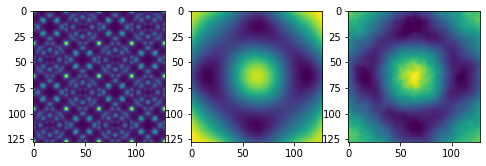

339
Log loss is:  184.27236100985618


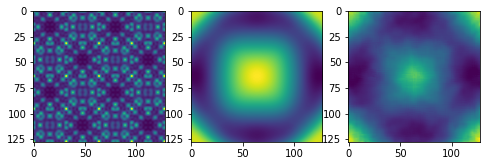

340
Log loss is:  76.14594514924579


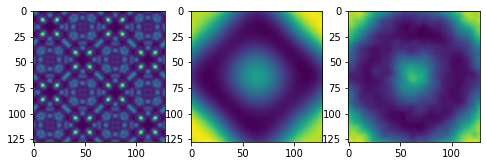

341
Log loss is:  8.734703331450731


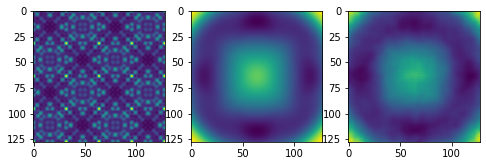

Average loss:  112.18079982640252


In [13]:
average_loss = 0
data = [i for i in gen_paths_labels(data_path)]
#data[0][0], data[0][1]
for i in range(0, len(data[0][0])):
    x = np.load(data[0][0][i])
    y = np.load(data[0][1][i])
    #x = np.load(data[0][i])
    #y = np.load(data[1][i])
    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    #print(i)
    log_loss = 0
    for j in range(0, a.shape[0]):
        for k in range(0, a.shape[1]):
            log_loss+=(math.log(1+a[j][k]) - math.log(1+y[j][k])) ** 2
    
    average_loss+=log_loss
    if log_loss > 0:
        print(i)
        print("Log loss is: ", log_loss)
        w=10
        h=10
        fig=plt.figure(figsize=(8, 8))
        columns = 3
        rows = 1
        fig.add_subplot(rows, columns, 1)
        plt.imshow(x)
        fig.add_subplot(rows, columns, 2)
        plt.imshow(y)
        fig.add_subplot(rows, columns, 3)
        plt.imshow(a)
        plt.show()
print("Average loss: ", average_loss / len(data[0][0]))

In [14]:
for i in range(0, len(TrainingPaths[0])):
    #x = np.load(data[0][0][i])
    #y = np.load(data[0][1][i])
    x = np.load(TrainingPaths[0][i])
    y = np.load(TrainingPaths[1][i])
    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    print(TrainingPaths[0][i])

    w=10
    h=10
    fig=plt.figure(figsize=(8, 8))
    columns = 3
    rows = 1
    fig.add_subplot(rows, columns, 1)
    plt.imshow(x)
    fig.add_subplot(rows, columns, 2)
    plt.imshow(y)
    fig.add_subplot(rows, columns, 3)
    plt.imshow(a)
    plt.show()

NameError: name 'TrainingPaths' is not defined